In [105]:
import numpy as np
import pandas as pd

import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn import preprocessing
import matplotlib.pyplot as plt # plotting
%matplotlib inline
from sklearn.decomposition import PCA
sns.set(rc={'figure.figsize':(10,5)})
import os # accessing directory structure
import locale
from tslearn.clustering import TimeSeriesKMeans

from tslearn.preprocessing import TimeSeriesScalerMeanVariance, TimeSeriesResampler
from sklearn.model_selection import train_test_split

In [106]:
df_old = pd.read_csv('BitcoinHeistData.csv')

In [308]:
df_old.shape

(918545, 7)

In [107]:
print(df_old.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 10 columns):
 #   Column     Non-Null Count    Dtype  
---  ------     --------------    -----  
 0   address    1048575 non-null  object 
 1   year       1048575 non-null  int64  
 2   day        1048575 non-null  int64  
 3   length     1048575 non-null  int64  
 4   weight     1048575 non-null  float64
 5   count      1048575 non-null  int64  
 6   looped     1048575 non-null  int64  
 7   neighbors  1048575 non-null  int64  
 8   income     1048575 non-null  float64
 9   label      1048575 non-null  object 
dtypes: float64(2), int64(6), object(2)
memory usage: 80.0+ MB
None


In [108]:
df_old.head()

,address,year,day,length,weight,count,looped,neighbors,income,label
0,111K8kZAEnJg245r2cM6y9zgJGHZtJPy6,2017,11,18,0.008333,1,0,2,100050000.0,princetonCerber
1,1123pJv8jzeFQaCV4w644pzQJzVWay2zcA,2016,132,44,0.000244,1,0,1,100000000.0,princetonLocky
2,112536im7hy6wtKbpH1qYDWtTyMRAcA2p7,2016,246,0,1.000000,1,0,2,200000000.0,princetonCerber
3,1126eDRw2wqSkWosjTCre8cjjQW8sSeWH7,2016,322,72,0.003906,1,0,2,71200000.0,princetonCerber
4,1129TSjKtx65E35GiUo4AYVeyo48twbrGX,2016,238,144,0.072848,456,0,1,200000000.0,princetonLocky


## Features:

- Address column is the bitcoin address
- Year column is the year in which the transaction took place.
- Day column is the day of the year, 1 denotes the first day, 365 is the last day of the year.
- Length column is designed to quantify mixing rounds on Bitcoin. This means that the dataset analyses the transactions where transactions receive and distribute similar amounts of coins in multiple rounds with newly created addresses to hide the coin origin. This allows us to identify ransomware addresses since the same amount is circulating till the coins are cashed out to avoid getting identified by the authorities.
- Weight column quantifies the merge behavior (i.e., the transaction has more input addresses than output addresses), where coins in multiple addresses are each passed through a succession of merging transactions and accumulated in a final address. It represents information on the amount of transactions i.e., what percent of these transactions’ output?
- Count feature is designed to quantify the merging pattern, it represents information on the number of transactions.
- Loop column is intended to count how many transaction i) split their coins; ii) move these coins in the network by using different paths and finally, and iii) merge them in a single address. Coins at this final address can then be sold and converted to fiat currency.
- Income column quantifies the Satoshi amount (1 bitcoin = 100 million satoshis).
- Label denotes if the address is ransomware or white. Name of the ransomware family (e.g., Cryptxxx, cryptolocker etc) or white (i.e., not known to be ransomware). Though the ransomware labels are true ransomware the dataset of white addresses cannot be confirmed as true white.
- The number of white addresses in the dataset are capped at 1K perday. (Bitcoin has 800K addresses daily).


In [109]:
np.shape(df_old)

(1048575, 10)

The dataset is filtered off of the network edges that transfer less than B0.3, since ransom amounts are rarely below this threshold

In [110]:
labels= df_old.label.unique()
labels

array(['princetonCerber', 'princetonLocky', 'montrealCryptoLocker',
       'montrealCryptXXX', 'paduaCryptoWall', 'montrealWannaCry',
       'montrealDMALockerv3', 'montrealCryptoTorLocker2015',
       'montrealSamSam', 'montrealFlyper', 'montrealNoobCrypt',
       'montrealDMALocker', 'montrealGlobe', 'montrealEDA2',
       'paduaKeRanger', 'montrealVenusLocker', 'montrealXTPLocker',
       'paduaJigsaw', 'montrealGlobev3', 'montrealJigSaw',
       'montrealXLockerv5.0', 'montrealXLocker', 'montrealRazy',
       'montrealCryptConsole', 'montrealGlobeImposter', 'montrealSam',
       'montrealComradeCircle', 'montrealAPT', 'white'], dtype=object)

Ransomware addresses of this dataset are taken from three widely adopted studies: Montreal, Princeton and Padua

In [111]:
years = df_old.year.unique()
years.sort()
years

array([2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018], dtype=int64)

In [112]:
year_label = df_old.groupby(['year','label']).size().unstack()
year_label

label,montrealAPT,montrealComradeCircle,montrealCryptConsole,montrealCryptXXX,montrealCryptoLocker,montrealCryptoTorLocker2015,montrealDMALocker,montrealDMALockerv3,montrealEDA2,montrealFlyper,...,montrealWannaCry,montrealXLocker,montrealXLockerv5.0,montrealXTPLocker,paduaCryptoWall,paduaJigsaw,paduaKeRanger,princetonCerber,princetonLocky,white
year,,,,,,,,,,,,,,,,,,,,,
2011,NaN,NaN,NaN,NaN,65.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,355284.0
2012,NaN,NaN,NaN,NaN,714.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,365000.0
2013,NaN,NaN,NaN,NaN,7484.0,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,286878.0
2014,NaN,NaN,NaN,NaN,1050.0,1.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,9157.0,NaN,NaN,NaN,NaN,NaN
2015,NaN,NaN,NaN,NaN,2.0,53.0,73.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,3233.0,NaN,NaN,NaN,NaN,NaN
2016,5.0,1.0,NaN,2419.0,NaN,1.0,178.0,193.0,3.0,7.0,...,NaN,NaN,NaN,8.0,NaN,2.0,10.0,6043.0,6585.0,NaN
2017,6.0,NaN,7.0,NaN,NaN,NaN,NaN,161.0,3.0,NaN,...,28.0,1.0,7.0,NaN,NaN,NaN,NaN,3180.0,40.0,NaN
2018,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


The dataset builds a bitcoin transaction graph from 2011 January to 2018 December using a time interval of 24 hour.

In [113]:
df_old['Date']=pd.to_datetime(df_old['year'] * 1000 + df_old['day'], format='%Y%j')

In [114]:
first_column = df_old.pop('Date')
df_old.insert(0, 'Date', first_column)

In [115]:
df_old.sort_values(by='Date', inplace = True)

In [116]:
df_old.head()

,Date,address,year,day,length,weight,count,looped,neighbors,income,label
41744,2011-01-01,14MHuJNyMf5UQTudUqN2citSNAEwchvWHS,2011,1,34,0.515627,2,1,2,3.900000e+07,white
41735,2011-01-01,15o426FcRMMfrqraQNH33SSC61KTJzCmCf,2011,1,30,0.000015,1,0,2,4.200000e+07,white
41734,2011-01-01,15kdYSNRRGxKbzjZW6wm5kruWvG82LRf3b,2011,1,10,0.015625,1,0,1,4.670000e+09,white
41733,2011-01-01,17r2LaR5tFVA1YbbYGfysWm1enDFw9L4GX,2011,1,10,0.015625,1,0,1,2.230000e+08,white
41732,2011-01-01,1GFSRwmwzr189U1Yt3x3vCcDuqvhbqs8aM,2011,1,14,0.324619,20,0,1,4.310000e+09,white


In [117]:
df_old=df_old.drop(['year','day'], axis=1)

In [118]:
df_old.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1048575 entries, 41744 to 11756
Data columns (total 9 columns):
 #   Column     Non-Null Count    Dtype         
---  ------     --------------    -----         
 0   Date       1048575 non-null  datetime64[ns]
 1   address    1048575 non-null  object        
 2   length     1048575 non-null  int64         
 3   weight     1048575 non-null  float64       
 4   count      1048575 non-null  int64         
 5   looped     1048575 non-null  int64         
 6   neighbors  1048575 non-null  int64         
 7   income     1048575 non-null  float64       
 8   label      1048575 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(4), object(2)
memory usage: 80.0+ MB


In [119]:
df_old["label"].value_counts()

white                          1007162
paduaCryptoWall                  12390
montrealCryptoLocker              9315
princetonCerber                   9223
princetonLocky                    6625
montrealCryptXXX                  2419
montrealNoobCrypt                  483
montrealDMALockerv3                354
montrealDMALocker                  251
montrealSamSam                      62
montrealGlobeImposter               55
montrealCryptoTorLocker2015         55
montrealGlobev3                     34
montrealGlobe                       32
montrealWannaCry                    28
montrealRazy                        13
montrealAPT                         11
paduaKeRanger                       10
montrealFlyper                       9
montrealXTPLocker                    8
montrealVenusLocker                  7
montrealXLockerv5.0                  7
montrealCryptConsole                 7
montrealEDA2                         6
montrealJigSaw                       4
paduaJigsaw              

In [121]:
#select numerical columns
df_numerical= df_old.select_dtypes('number')
df_numerical

,length,weight,count,looped,neighbors,income
41744,34,0.515627,2,1,2,3.900000e+07
41735,30,0.000015,1,0,2,4.200000e+07
41734,10,0.015625,1,0,1,4.670000e+09
41733,10,0.015625,1,0,1,2.230000e+08
41732,14,0.324619,20,0,1,4.310000e+09
...,...,...,...,...,...,...
41407,2,1.666667,1,1,4,3.909360e+08
26678,144,0.090402,1408,0,2,1.000000e+08
38100,0,0.043478,1,0,1,1.099500e+08
23628,140,0.155440,6345,0,1,1.178321e+08


In [122]:
df_old["address"].nunique()

853358

In [123]:
address_count= df_old["address"].value_counts()
address_count

1LXrSb67EaH1LGc6d6kWHq8rgv4ZBQAcpU    420
16cVG72goMe4sNqZhnpmnqfCMZ1uSFbUit    261
12wQZTDmA8onM3sEt4jwcvzDxnNXxD8Vza    207
12YursV58dRT2c9iuZg3jEWfwgTDamBcnd    183
1LEq4WmpCrqBd7V3PywE2nvFUFC3QTe52x    176
                                     ... 
1C1J89vDocFvTxfKJDy4eBpFj9iTvBS1tv      1
1DLAKWyg8DvuyqUPCotP5QVtbiyghTJRSx      1
1LHNrXiDXFK1jXMW8fAHvLKhtkzwQoyu3g      1
1LG8RYpZvMAT9vNUZ1RFn9T5VUo1i5F7Wn      1
1P29xxkwy6wvLxJVA2cLoXBri2hZzaweSV      1
Name: address, Length: 853358, dtype: int64

In [124]:
a = df_old.groupby('address')['label'].value_counts()
a= pd.DataFrame(a)
a

,,label
address,label,
1111111111111111111114oLvT2,white,1
111111mg3JxXdXbypYNyERcYLaJdzEwb,white,2
1111DPPBAUk9NVKSPjmcRyALvnvGBbFY4,white,1
111213xkVmeHT1v7N7Ff43XmVfLAUq7WEZ,white,14
11126SM5WRmqGb3sdLBNesk5t3aZD9RuJq,white,1
...,...,...
3CEHHipzES8TYrMHutYMiXNZGSUJrWmXPe,white,1
3CK4fEwbMP7heJarmU4eqA3sMbVJyEnU3V,white,3
3DLCRW4v2zcMoWfk8HH95JvMtQgCKhgKYt,white,1


In [125]:
a['label'].unique()

array([  1,   2,  14,   7,   3,   5,   6,  36,  11,  10,   8,   4,  12,
        19,   9,  39,  20,  15,  21,  17,  22,  30,  28,  16,  45,  24,
        35,  27,  54,  29,  94,  25,  26,  13,  42,  32,  31,  76,  37,
        43,  66,  38,  18,  50, 143,  60,  67, 183,  23,  55,  46,  41,
       207,  48,  59,  90,  40,  83,  49,  65,  33,  44,  96,  51,  34,
        52,  47,  56,  63,  58,  75, 261, 112,  87, 126,  89,  53,  57,
        61,  70, 104, 118,  97,  74,  62,  82,  68,  77, 171,  64,  95,
       102,  85,  72, 106, 105, 176, 147, 420,  73,  80, 119,  71,  69,
       159, 101, 125], dtype=int64)

In [126]:
fig = plt.figure(figsize=(3,2))

<Figure size 216x144 with 0 Axes>

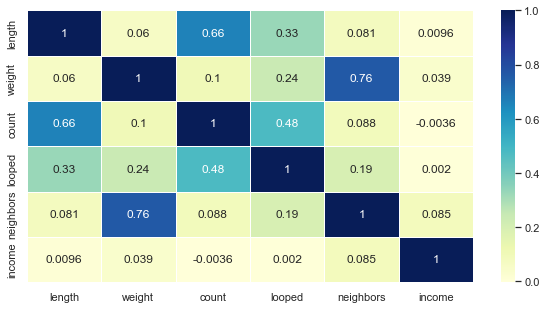

In [127]:
ax = sns.heatmap(df_old.corr(method='pearson'), cmap="YlGnBu",annot=True,linewidth =1)

The strength of a correlation (positive or negative) is typically assessed using the correlation coefficient, often denoted as "r". The correlation coefficient can range from -1 to 1, where:
- 1 indicates a perfect positive correlation.
- -1 indicates a perfect negative correlation.
- 0 indicates no linear correlation between the variables.
So, how "low" a correlation needs to be to be considered weak depends on what you're measuring and the context of your analysis.
- Here's a general guideline:
    - 0.7 to 1.0 (or -0.7 to -1.0): Strong correlation. Variables have a strong linear relationship.
    - 0.4 to 0.7 (or -0.4 to -0.7): Moderate correlation. Variables have a moderate linear relationship.
    - 0.2 to 0.4 (or -0.2 to -0.4): Weak correlation. Variables have a weak linear relationship.
    - 0.0 to 0.2 (or -0.0 to -0.2): Very weak or no correlation. Variables have little to no linear relationship.

- The columns 'weight' and 'neighbors' are correlated to each other by 76%. We can drop the neighbors column.

In [128]:
df_old = df_old.drop(['neighbors'], axis=1)
df_old

,Date,address,length,weight,count,looped,income,label
41744,2011-01-01,14MHuJNyMf5UQTudUqN2citSNAEwchvWHS,34,0.515627,2,1,3.900000e+07,white
41735,2011-01-01,15o426FcRMMfrqraQNH33SSC61KTJzCmCf,30,0.000015,1,0,4.200000e+07,white
41734,2011-01-01,15kdYSNRRGxKbzjZW6wm5kruWvG82LRf3b,10,0.015625,1,0,4.670000e+09,white
41733,2011-01-01,17r2LaR5tFVA1YbbYGfysWm1enDFw9L4GX,10,0.015625,1,0,2.230000e+08,white
41732,2011-01-01,1GFSRwmwzr189U1Yt3x3vCcDuqvhbqs8aM,14,0.324619,20,0,4.310000e+09,white
...,...,...,...,...,...,...,...,...
41407,2017-12-01,35iCvpMMnUWcSWrYtLJLXqe9xo5CYEWRhw,2,1.666667,1,1,3.909360e+08,montrealAPT
26678,2017-12-27,1GvgRRnLpUP7KsLZLE23ridD45MUxHoAJ4,144,0.090402,1408,0,1.000000e+08,montrealGlobeImposter
38100,2018-05-01,1P29xxkwy6wvLxJVA2cLoXBri2hZzaweSV,0,0.043478,1,0,1.099500e+08,montrealFlyper
23628,2018-05-14,1F1tAaz5x1HUXrCNLbtMDqcw6o5GNn4xqX,140,0.155440,6345,0,1.178321e+08,montrealRazy


In [129]:
df_old.shape

(1048575, 8)

In [131]:
start_date = df_old['Date'].min()
end_date = df_old['Date'].max()
dates = pd.date_range(start=start_date, end=end_date, freq='M')

In [132]:
dates

DatetimeIndex(['2011-01-31', '2011-02-28', '2011-03-31', '2011-04-30',
               '2011-05-31', '2011-06-30', '2011-07-31', '2011-08-31',
               '2011-09-30', '2011-10-31', '2011-11-30', '2011-12-31',
               '2012-01-31', '2012-02-29', '2012-03-31', '2012-04-30',
               '2012-05-31', '2012-06-30', '2012-07-31', '2012-08-31',
               '2012-09-30', '2012-10-31', '2012-11-30', '2012-12-31',
               '2013-01-31', '2013-02-28', '2013-03-31', '2013-04-30',
               '2013-05-31', '2013-06-30', '2013-07-31', '2013-08-31',
               '2013-09-30', '2013-10-31', '2013-11-30', '2013-12-31',
               '2014-01-31', '2014-02-28', '2014-03-31', '2014-04-30',
               '2014-05-31', '2014-06-30', '2014-07-31', '2014-08-31',
               '2014-09-30', '2014-10-31', '2014-11-30', '2014-12-31',
               '2015-01-31', '2015-02-28', '2015-03-31', '2015-04-30',
               '2015-05-31', '2015-06-30', '2015-07-31', '2015-08-31',
      

In [133]:
df_old.Date.unique()

array(['2011-01-01T00:00:00.000000000', '2011-01-02T00:00:00.000000000',
       '2011-01-03T00:00:00.000000000', ...,
       '2018-05-01T00:00:00.000000000', '2018-05-14T00:00:00.000000000',
       '2018-09-30T00:00:00.000000000'], dtype='datetime64[ns]')

In [134]:
df_old = df_old.dropna(subset=['Date'])

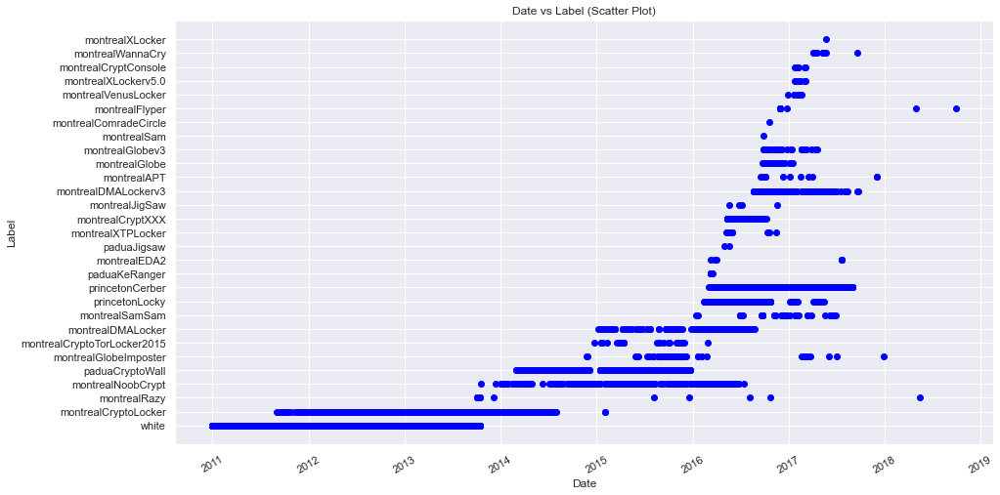

In [135]:
plt.rcParams["figure.figsize"] = (20,10)
plt.figure(figsize=(15, 8))
plt.scatter(df_old['Date'], df_old['label'], color='blue')
plt.title('Date vs Label (Scatter Plot)')
plt.xlabel('Date')
plt.ylabel('Label')
plt.xticks(rotation=30)
plt.show()

In [136]:
df_old.looped.unique()

array([    1,     0,    20, ...,  8315,  8005, 11693], dtype=int64)

In [137]:
df_old = df_old.dropna(subset=['looped'])

We see that the data has transactions starting from date 1st Jan 2011 to 30th Sept 2018

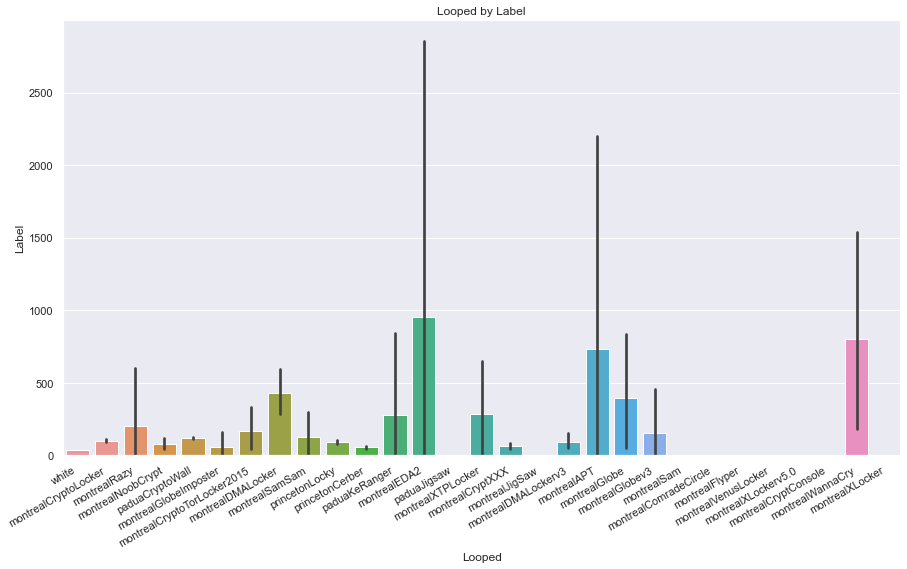

In [138]:
plt.rcParams["figure.figsize"] = (15,8)

sns.barplot(x='label', y='looped', data=df_old)

# Giving title to the chart using plt.title
plt.title('Looped by Label')

# rotating the x-axis tick labels at 30degree
# towards right
plt.xticks(rotation=30, ha='right')

# Providing x and y label to the chart
plt.xlabel('Looped')
plt.ylabel('Label')
plt.show()

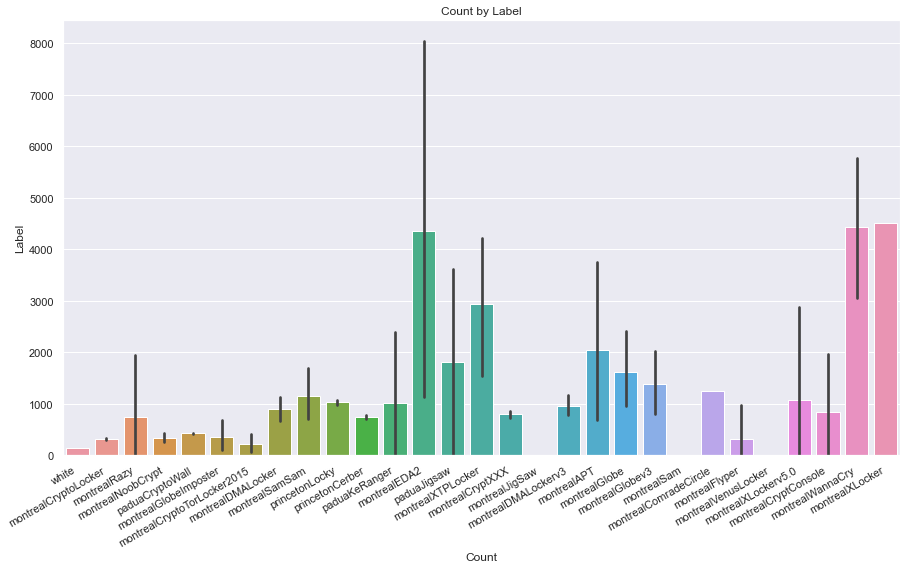

In [139]:
# Giving title to the chart using plt.title
plt.title('Count by Label')
sns.barplot(x='label', y='count', data=df_old)
plt.xticks(rotation=30, ha='right')
plt.xlabel("Count")  # add X-axis label
plt.ylabel("Label")  # add Y-axis label
plt.show()

Text(0, 0.5, 'Label')

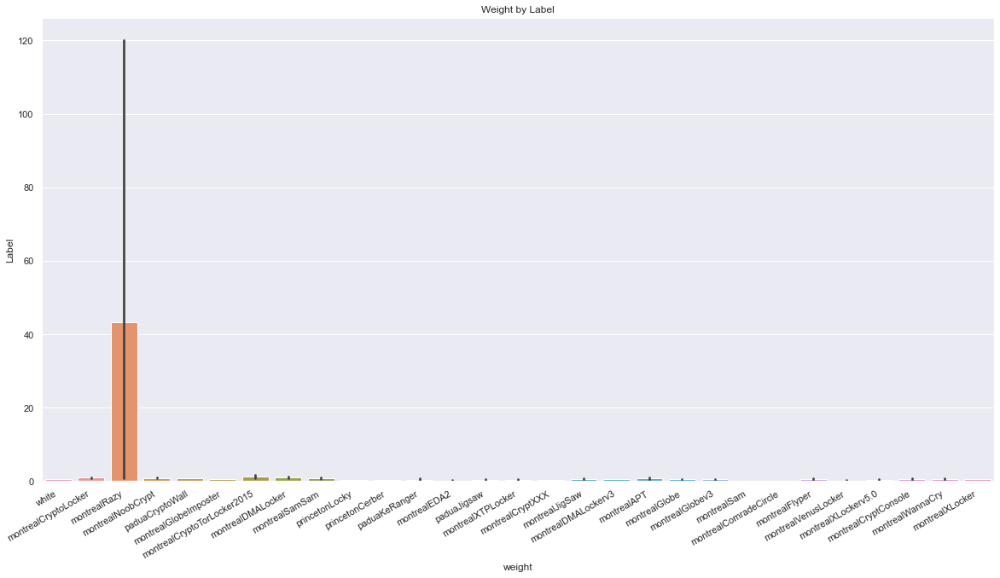

In [140]:
plt.rcParams["figure.figsize"] = (20,10)
sns.barplot(x='label', y='weight', data=df_old)

# Giving title to the chart using plt.title
plt.title('Weight by Label')

# rotating the x-axis tick labels at 30degree
# towards right
plt.xticks(rotation=30, ha='right')

# Providing x and y label to the chart
plt.xlabel('weight')
plt.ylabel('Label')

We see the weight of montrealRazy addresses is heavily skewed.We drop all rows with weight more than 100

In [141]:
df_old = df_old[df_old['weight'] <= 100]

Text(0, 0.5, 'Label')

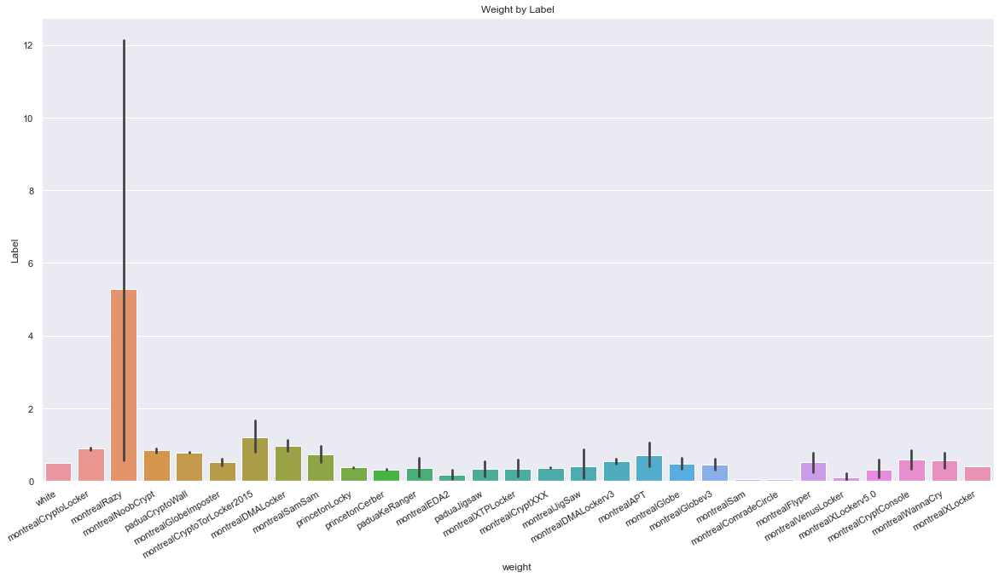

In [142]:
plt.rcParams["figure.figsize"] = (20,10)
sns.barplot(x='label', y='weight', data=df_old)

# Giving title to the chart using plt.title
plt.title('Weight by Label')

# rotating the x-axis tick labels at 30degree
# towards right
plt.xticks(rotation=30, ha='right')

# Providing x and y label to the chart
plt.xlabel('weight')
plt.ylabel('Label')

Text(0, 0.5, 'Label')

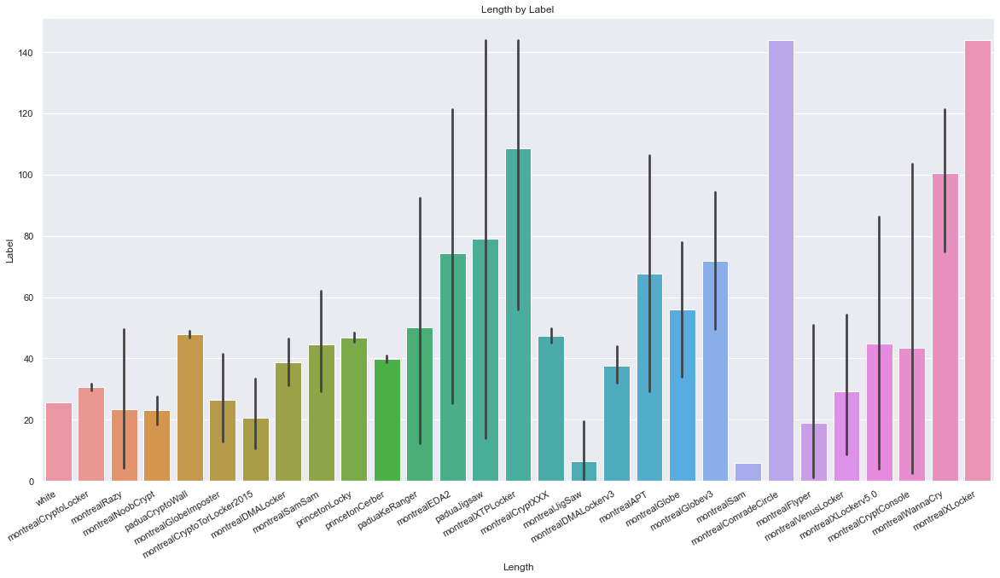

In [143]:
plt.rcParams["figure.figsize"] = (20,10)
sns.barplot(x='label', y='length', data=df_old)

# Giving title to the chart using plt.title
plt.title('Length by Label')

# rotating the x-axis tick labels at 30degree
# towards right
plt.xticks(rotation=30, ha='right')

# Providing x and y label to the chart
plt.xlabel('Length')
plt.ylabel('Label')

Text(0, 0.5, 'Label')

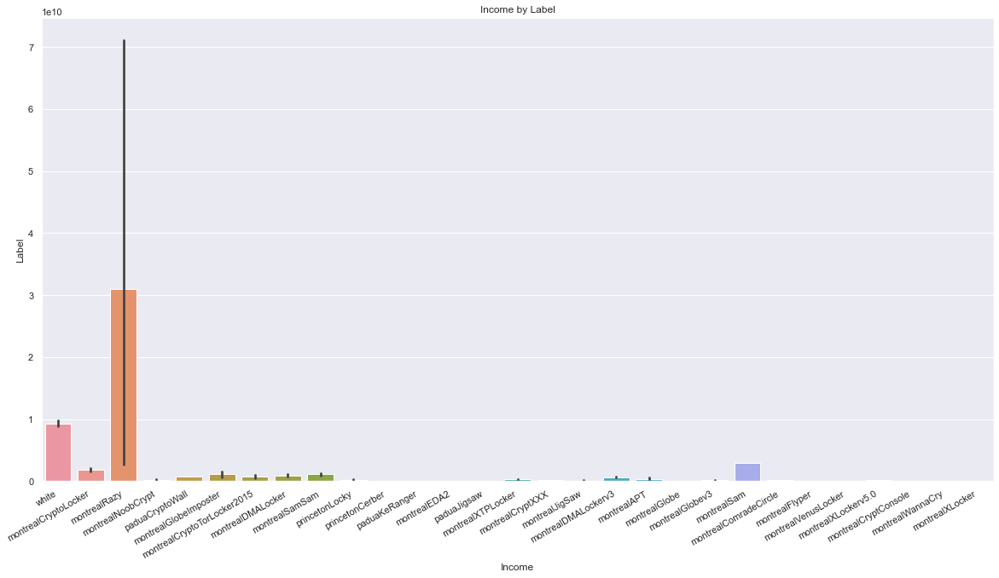

In [144]:
plt.rcParams["figure.figsize"] = (20,10)
sns.barplot(x='label', y='income', data=df_old)

# Giving title to the chart using plt.title
plt.title('Income by Label')

# rotating the x-axis tick labels at 30degree
# towards right
plt.xticks(rotation=30, ha='right')

# Providing x and y label to the chart
plt.xlabel('Income')
plt.ylabel('Label')

We see that the data is heavily skewed for the possible white labled addresses.

In [145]:
label_counter= df_old.groupby('label')['income'].count()
label_counter

label
montrealAPT                         11
montrealComradeCircle                1
montrealCryptConsole                 7
montrealCryptXXX                  2419
montrealCryptoLocker              9315
montrealCryptoTorLocker2015         55
montrealDMALocker                  251
montrealDMALockerv3                354
montrealEDA2                         6
montrealFlyper                       9
montrealGlobe                       32
montrealGlobeImposter               55
montrealGlobev3                     34
montrealJigSaw                       4
montrealNoobCrypt                  483
montrealRazy                        12
montrealSam                          1
montrealSamSam                      62
montrealVenusLocker                  7
montrealWannaCry                    28
montrealXLocker                      1
montrealXLockerv5.0                  7
montrealXTPLocker                    8
paduaCryptoWall                  12390
paduaJigsaw                          2
paduaKeRanger      

In [146]:
# Step 2: Define threshold (for example, 1.5, but you can adjust this as needed)
threshold = 10

# Step 3: Filter rows based on skewness
labels_to_replace = label_counter[label_counter < threshold].index.tolist()
labels_to_replace

['montrealComradeCircle',
 'montrealCryptConsole',
 'montrealEDA2',
 'montrealFlyper',
 'montrealJigSaw',
 'montrealSam',
 'montrealVenusLocker',
 'montrealXLocker',
 'montrealXLockerv5.0',
 'montrealXTPLocker',
 'paduaJigsaw']

In [147]:
df_old['label'] = df_old['label'].apply(lambda x: 'others' if x in labels_to_replace else x)

In [148]:
df_old.columns

Index(['Date', 'address', 'length', 'weight', 'count', 'looped', 'income',
       'label'],
      dtype='object')

We drop address column as it does not add any value to our analysis

In [149]:
df_old = df_old.drop(['address'],axis=1)
df_old

,Date,length,weight,count,looped,income,label
41744,2011-01-01,34,0.515627,2,1,3.900000e+07,white
41735,2011-01-01,30,0.000015,1,0,4.200000e+07,white
41734,2011-01-01,10,0.015625,1,0,4.670000e+09,white
41733,2011-01-01,10,0.015625,1,0,2.230000e+08,white
41732,2011-01-01,14,0.324619,20,0,4.310000e+09,white
...,...,...,...,...,...,...,...
41407,2017-12-01,2,1.666667,1,1,3.909360e+08,montrealAPT
26678,2017-12-27,144,0.090402,1408,0,1.000000e+08,montrealGlobeImposter
38100,2018-05-01,0,0.043478,1,0,1.099500e+08,others
23628,2018-05-14,140,0.155440,6345,0,1.178321e+08,montrealRazy


## Outlier treatment

In [150]:
#describe dataframe
df_old.describe(percentiles=[.25,.5,.75,.90,.95,.99])

,length,weight,count,looped,income
count,1.048340e+06,1.048340e+06,1.048340e+06,1.048340e+06,1.048340e+06
mean,2.629180e+01,5.074337e-01,1.575948e+02,3.544854e+01,8.974928e+09
std,4.268950e+01,1.882002e+00,6.008951e+02,2.849221e+02,2.553038e+11
min,0.000000e+00,3.610000e-94,1.000000e+00,0.000000e+00,3.000000e+07
25%,0.000000e+00,1.895117e-02,1.000000e+00,0.000000e+00,1.086353e+08
50%,6.000000e+00,2.500000e-01,1.000000e+00,0.000000e+00,5.000000e+08
75%,2.800000e+01,5.573896e-01,8.000000e+00,0.000000e+00,2.516046e+09
90%,1.060000e+02,1.000000e+00,6.800000e+01,0.000000e+00,7.522973e+09
95%,1.440000e+02,1.013021e+00,1.344000e+03,2.000000e+00,1.600000e+10
99%,1.440000e+02,3.053405e+00,3.330000e+03,1.503000e+03,8.957236e+10


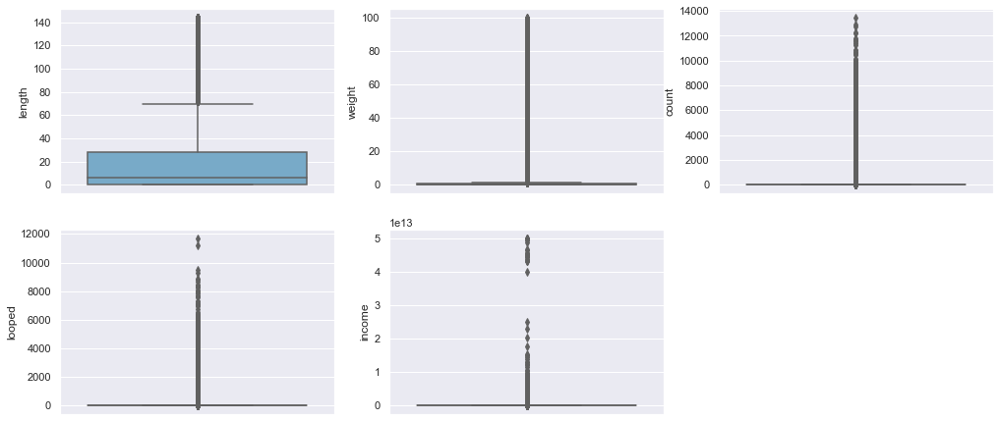

In [151]:
plt.figure(figsize=(17, 20))
plt.subplot(5,3,1)
sns.boxplot(y = 'length', palette="Blues", data = df_old)
plt.subplot(5,3,2)
sns.boxplot(y = 'weight', palette="Blues", data = df_old)
plt.subplot(5,3,3)
sns.boxplot(y = 'count', palette="Blues", data = df_old)
plt.subplot(5,3,4)
sns.boxplot(y = 'looped', palette="Blues", data = df_old)
plt.subplot(5,3,5)
sns.boxplot(y = 'income', palette="Blues", data = df_old)
plt.show()


In [152]:
# removing (statistical) outliers
Q1 = df_old.length.quantile(0.05)
Q3 = df_old.length.quantile(0.90)
IQR = Q3 - Q1
df_old = df_old[(df_old.length >= Q1 - 1.5*IQR) & (df_old.length <= Q3 + 1.5*IQR)]

# outlier treatment for recency
Q1 = df_old.weight.quantile(0.05)
Q3 = df_old.weight.quantile(0.90)
IQR = Q3 - Q1
df_old = df_old[(df_old.weight >= Q1 - 1.5*IQR) & (df_old.weight <= Q3 + 1.5*IQR)]

Q1 = df_old['count'].quantile(0.05)
Q3 = df_old['count'].quantile(0.99)
IQR = Q3 - Q1
df_old = df_old[(df_old['count'] >= Q1 - 1.5*IQR) & (df_old['count'] <= Q3 + 1.5*IQR)]

Q1 = df_old.looped.quantile(0.05)
Q3 = df_old.looped.quantile(0.99)
IQR = Q3 - Q1
df1 = df_old[(df_old.looped >= Q1 - 1.5*IQR) & (df_old.looped <= Q3 + 1.5*IQR)]


Q1 = df_old.income.quantile(0.05)
Q3 = df_old.income.quantile(0.75)
IQR = Q3 - Q1
df_old = df_old[(df_old.income >= Q1 - 1.5*IQR) & (df_old.income <= Q3 + 1.5*IQR)]

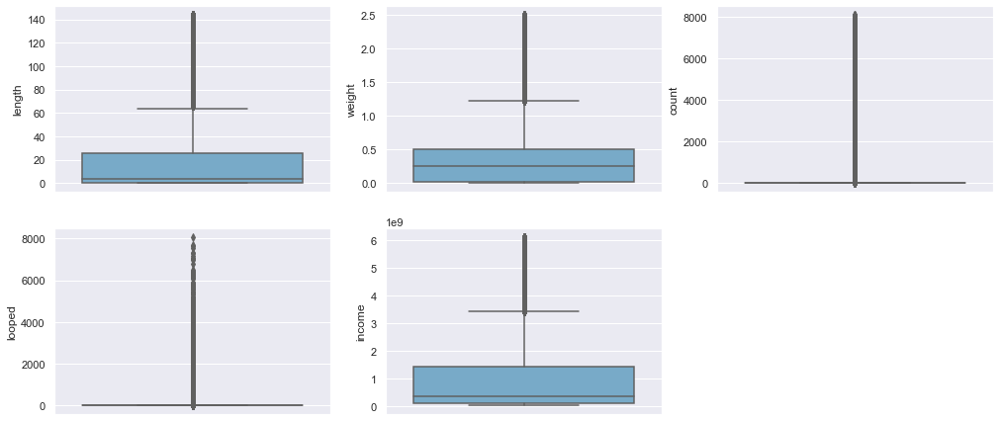

In [153]:
plt.figure(figsize=(17, 20))
plt.subplot(5,3,1)
sns.boxplot(y = 'length', palette="Blues", data = df_old)
plt.subplot(5,3,2)
sns.boxplot(y = 'weight', palette="Blues", data = df_old)
plt.subplot(5,3,3)
sns.boxplot(y = 'count', palette="Blues", data = df_old)
plt.subplot(5,3,4)
sns.boxplot(y = 'looped', palette="Blues", data = df_old)
plt.subplot(5,3,5)
sns.boxplot(y = 'income', palette="Blues", data = df_old)
plt.show()


In [154]:
df1=df_old.copy()

## Prepare the data for modelling

In [155]:
from sklearn.preprocessing import MinMaxScaler

# Create a Minmax scalerScaler object
scaler = MinMaxScaler()

# Fit and transform the data
df1[['length','weight','count','looped','income']] = scaler.fit_transform(df1[['length','weight','count','looped','income']])
df1

,Date,length,weight,count,looped,income,label
41744,2011-01-01,0.236111,0.206266,0.000123,0.000124,0.001480,white
41735,2011-01-01,0.208333,0.000006,0.000000,0.000000,0.001973,white
41734,2011-01-01,0.069444,0.006250,0.000000,0.000000,0.763026,white
41733,2011-01-01,0.069444,0.006250,0.000000,0.000000,0.031738,white
41732,2011-01-01,0.097222,0.129857,0.002340,0.000000,0.703826,white
...,...,...,...,...,...,...,...
41407,2017-12-01,0.013889,0.666715,0.000000,0.000124,0.059354,montrealAPT
26678,2017-12-27,1.000000,0.036163,0.173297,0.000000,0.011511,montrealGlobeImposter
38100,2018-05-01,0.000000,0.017393,0.000000,0.000000,0.013147,others
23628,2018-05-14,0.972222,0.062181,0.781377,0.000000,0.014444,montrealRazy


In [156]:
#describe dataframe
df1.describe(percentiles=[.25,.5,.75,.90,.95,.99])

,length,weight,count,looped,income
count,918545.000000,918545.000000,918545.000000,918545.000000,918545.000000
mean,0.178460,0.155858,0.019604,0.003866,0.168449
std,0.295340,0.169727,0.074025,0.032832,0.234548
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.007499,0.000000,0.000000,0.011658
50%,0.027778,0.100007,0.000000,0.000000,0.051800
75%,0.180556,0.200015,0.000862,0.000000,0.230223
90%,0.736111,0.400029,0.008252,0.000000,0.570625
95%,1.000000,0.400029,0.168370,0.000124,0.748226
99%,1.000000,0.700051,0.412612,0.170692,0.896227


In [159]:
grouped = df1.groupby('label')

In [160]:
grouped_dict = {}

# Iterate through the groups and store them in the dictionary
for label, group in grouped:
    grouped_dict[label] = group
grouped_dict

{'montrealAPT':             Date    length    weight     count    looped    income  \
 41409 2016-09-15  0.013889  0.600044  0.000123  0.000000  0.007317   
 41411 2016-09-27  0.041667  0.050004  0.000000  0.000000  0.011511   
 41410 2016-10-03  0.000000  0.200015  0.000000  0.000000  0.004464   
 41412 2016-10-04  1.000000  0.123900  0.601182  0.000000  0.159512   
 41405 2016-12-10  1.000000  0.480763  0.335509  0.000000  0.025982   
 41404 2017-01-05  0.041667  0.200015  0.000000  0.000000  0.025982   
 41406 2017-02-15  1.000000  0.069887  0.475182  0.000000  0.041440   
 41408 2017-03-17  1.000000  0.550041  0.994581  1.000000  0.089242   
 41403 2017-03-31  0.055556  0.125009  0.000000  0.000124  0.174082   
 41402 2017-11-30  1.000000  0.047837  0.365439  0.000000  0.019733   
 41407 2017-12-01  0.013889  0.666715  0.000000  0.000124  0.059354   
 
              label  
 41409  montrealAPT  
 41411  montrealAPT  
 41410  montrealAPT  
 41412  montrealAPT  
 41405  montrealAPT  

In [161]:
keys = []
for key in grouped_dict:
    keys.append(key)

keys

['montrealAPT',
 'montrealCryptXXX',
 'montrealCryptoLocker',
 'montrealCryptoTorLocker2015',
 'montrealDMALocker',
 'montrealDMALockerv3',
 'montrealGlobe',
 'montrealGlobeImposter',
 'montrealGlobev3',
 'montrealNoobCrypt',
 'montrealRazy',
 'montrealSamSam',
 'montrealWannaCry',
 'others',
 'paduaCryptoWall',
 'paduaKeRanger',
 'princetonCerber',
 'princetonLocky',
 'white']

In [162]:
for key, df in grouped_dict.copy().items():
    if key == 'white':
        del grouped_dict[key]

We drop all white labled data as we are primarily focusing on clustering time series of ransomware labels

In [163]:
columns_to_remove = ['Date', 'label']

# Dictionary to store removed columns
removed_columns_dict = {}

# Step 1: Create a copy of the columns to remove
for key, df in grouped_dict.items():
    removed_columns_dict[key] = df[columns_to_remove].copy()

# Step 2: Remove the columns from the DataFrames
for key, df in grouped_dict.items():
    df.drop(columns=columns_to_remove, inplace=True)

# Step 3: Store the removed columns for later use
for key, removed_columns in removed_columns_dict.items():
    print(f"Removed columns for {key}:")
    print(removed_columns)
    print('-' * 20)

# Print the modified DataFrames
for key, df in grouped_dict.items():
    print(f"DataFrame for {key}:")
    print(df)
    print('-' * 20)

Removed columns for montrealAPT:
            Date        label
41409 2016-09-15  montrealAPT
41411 2016-09-27  montrealAPT
41410 2016-10-03  montrealAPT
41412 2016-10-04  montrealAPT
41405 2016-12-10  montrealAPT
41404 2017-01-05  montrealAPT
41406 2017-02-15  montrealAPT
41408 2017-03-17  montrealAPT
41403 2017-03-31  montrealAPT
41402 2017-11-30  montrealAPT
41407 2017-12-01  montrealAPT
--------------------
Removed columns for montrealCryptXXX:
            Date             label
39615 2016-05-11  montrealCryptXXX
15205 2016-05-12  montrealCryptXXX
37976 2016-05-12  montrealCryptXXX
35468 2016-05-12  montrealCryptXXX
181   2016-05-12  montrealCryptXXX
...          ...               ...
27763 2016-09-22  montrealCryptXXX
19011 2016-09-26  montrealCryptXXX
27765 2016-09-26  montrealCryptXXX
27764 2016-09-30  montrealCryptXXX
30191 2016-10-06  montrealCryptXXX

[2400 rows x 2 columns]
--------------------
Removed columns for montrealCryptoLocker:
            Date                 label
1

In [164]:
columns_to_add = ['Date']
for key, g_df in grouped_dict.items():
    for column in columns_to_add:
        g_df[column] = removed_columns_dict[key][column].values

# Print the PCA result DataFrames after adding back the columns
for key, g_df in grouped_dict.items():
    print(f"Result DataFrame for {key}:")
    print(g_df)
    print('-' * 20)

Result DataFrame for montrealAPT:
         length    weight     count    looped    income       Date
41409  0.013889  0.600044  0.000123  0.000000  0.007317 2016-09-15
41411  0.041667  0.050004  0.000000  0.000000  0.011511 2016-09-27
41410  0.000000  0.200015  0.000000  0.000000  0.004464 2016-10-03
41412  1.000000  0.123900  0.601182  0.000000  0.159512 2016-10-04
41405  1.000000  0.480763  0.335509  0.000000  0.025982 2016-12-10
41404  0.041667  0.200015  0.000000  0.000000  0.025982 2017-01-05
41406  1.000000  0.069887  0.475182  0.000000  0.041440 2017-02-15
41408  1.000000  0.550041  0.994581  1.000000  0.089242 2017-03-17
41403  0.055556  0.125009  0.000000  0.000124  0.174082 2017-03-31
41402  1.000000  0.047837  0.365439  0.000000  0.019733 2017-11-30
41407  0.013889  0.666715  0.000000  0.000124  0.059354 2017-12-01
--------------------
Result DataFrame for montrealCryptXXX:
         length    weight     count  looped    income       Date
39615  1.000000  0.025727  0.372090  

In [165]:
for label, g_df in grouped_dict.items():
    g_df.set_index('Date', inplace=True)

In [166]:
for label, g_df in grouped_dict.items():
    print(f"Results for {label}:")
    print(g_df)
    print('-' * 20)

Results for montrealAPT:
              length    weight     count    looped    income
Date                                                        
2016-09-15  0.013889  0.600044  0.000123  0.000000  0.007317
2016-09-27  0.041667  0.050004  0.000000  0.000000  0.011511
2016-10-03  0.000000  0.200015  0.000000  0.000000  0.004464
2016-10-04  1.000000  0.123900  0.601182  0.000000  0.159512
2016-12-10  1.000000  0.480763  0.335509  0.000000  0.025982
2017-01-05  0.041667  0.200015  0.000000  0.000000  0.025982
2017-02-15  1.000000  0.069887  0.475182  0.000000  0.041440
2017-03-17  1.000000  0.550041  0.994581  1.000000  0.089242
2017-03-31  0.055556  0.125009  0.000000  0.000124  0.174082
2017-11-30  1.000000  0.047837  0.365439  0.000000  0.019733
2017-12-01  0.013889  0.666715  0.000000  0.000124  0.059354
--------------------
Results for montrealCryptXXX:
              length    weight     count  looped    income
Date                                                      
2016-05-11  1

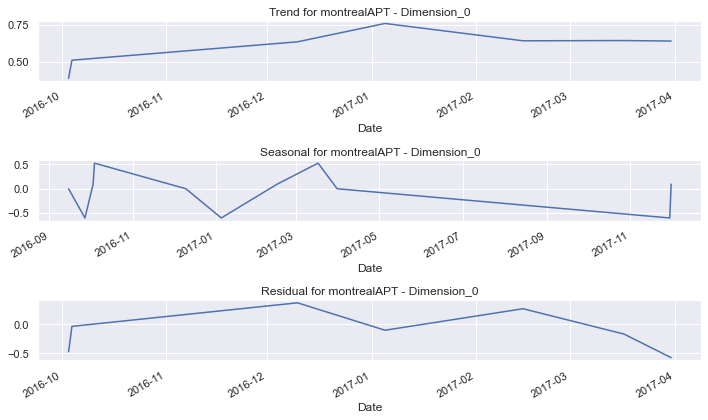

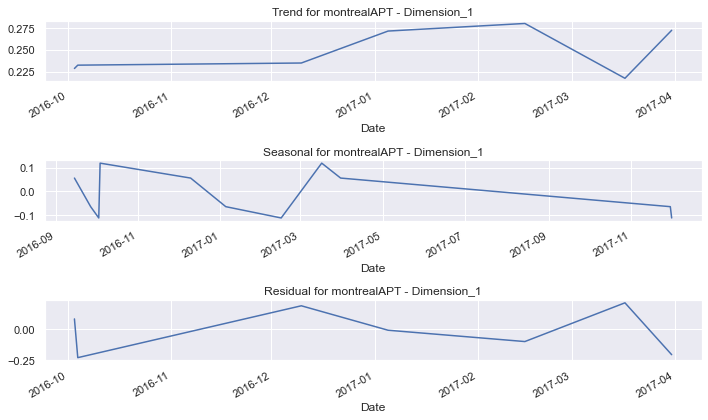

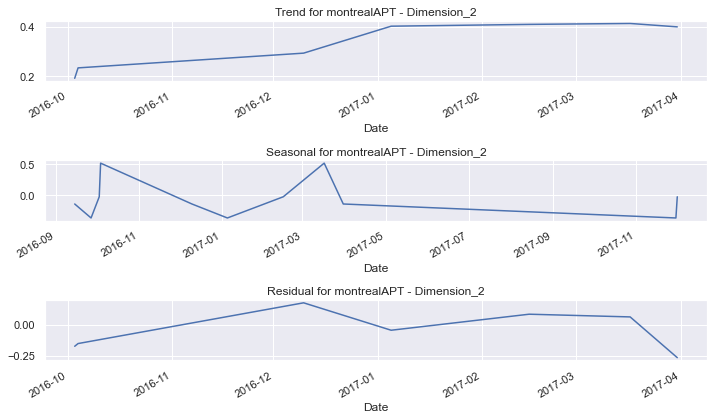

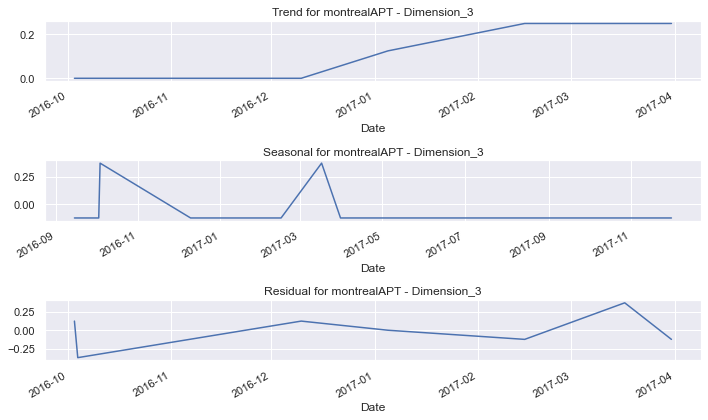

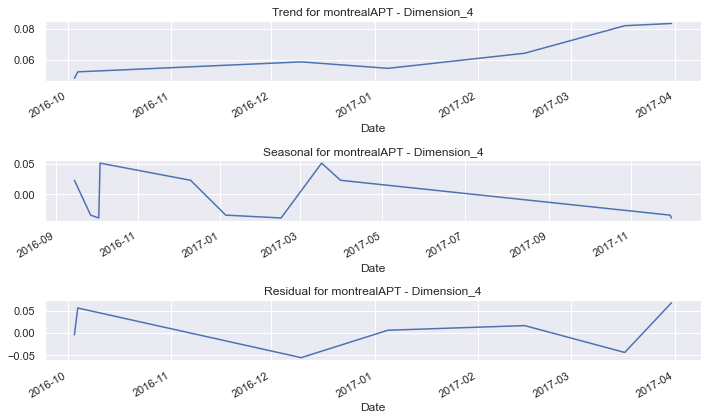

...

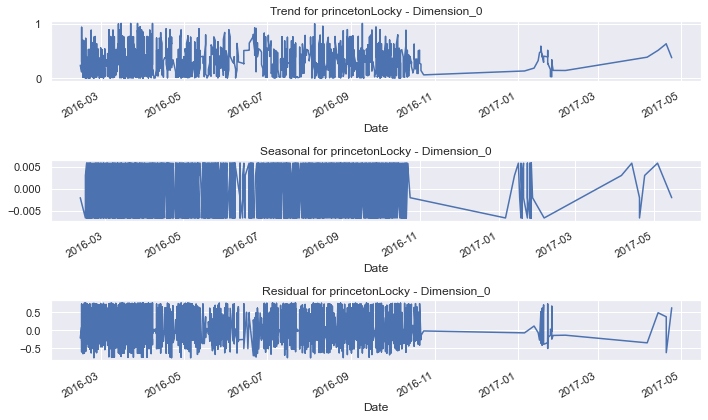

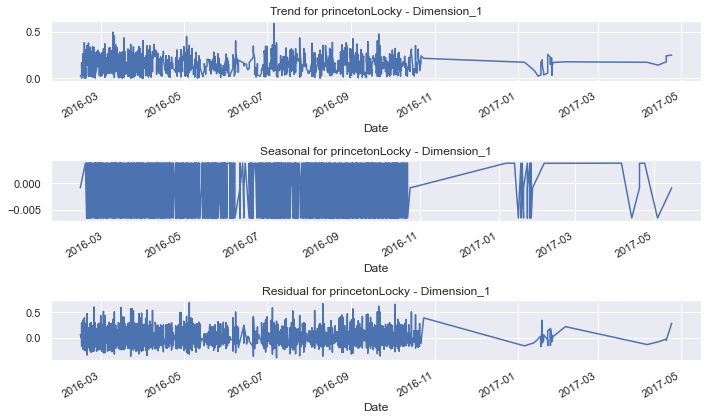

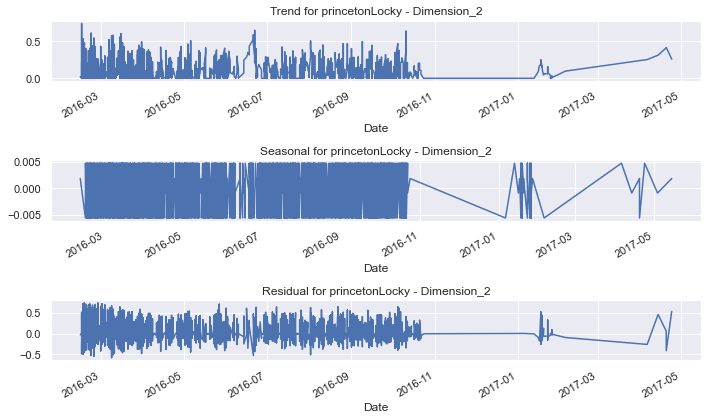

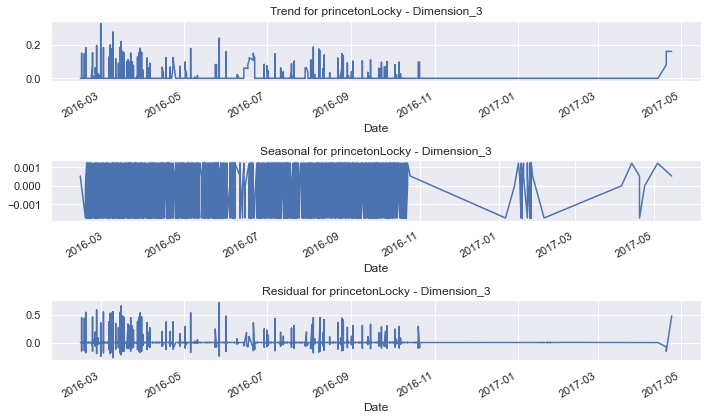

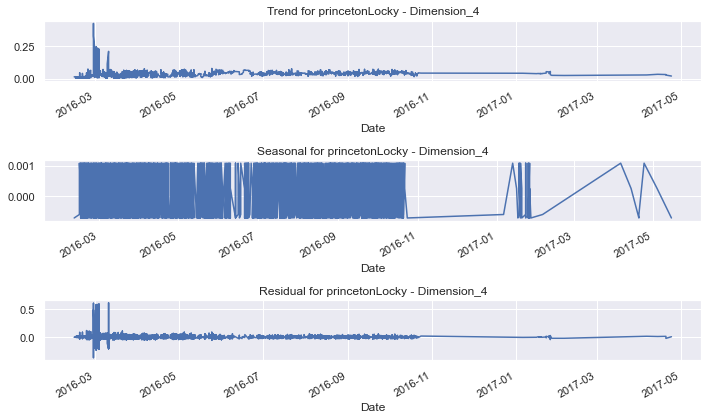

In [167]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Assuming you have a DataFrame 'df' and 'column_name' is the column you want to process
seasonal_period = 4  # Adjust based on your data

for key, data in grouped_dict.items():
    df = pd.DataFrame(data)
    df.columns = [f'Dimension_{i}' for i in range(df.shape[1])]  # Rename columns for clarity

    for col in df.columns:
        series = df[col]
        result = seasonal_decompose(series, model='additive', period=seasonal_period)

        fig, axes = plt.subplots(3, 1, figsize=(10, 6))

        # Plotting Trend
        result.trend.plot(ax=axes[0])
        axes[0].set_title(f'Trend for {key} - {col}')

        # Plotting Seasonal
        result.seasonal.plot(ax=axes[1])
        axes[1].set_title(f'Seasonal for {key} - {col}')

        # Plotting Residual
        result.resid.plot(ax=axes[2])
        axes[2].set_title(f'Residual for {key} - {col}')

        plt.tight_layout()
        plt.show()


In [168]:
from statsmodels.tsa.stattools import adfuller

# Function to perform ADF test and return results
def perform_adf_test(label, df, column):
    series = df[column]
    result = adfuller(series)
    adf_statistic = result[0]
    p_value = result[1]
    critical_values = result[4]
    stationary = p_value <= 0.05
    return {
        'ADF Statistic': adf_statistic,
        'p-value': p_value,
        'Critical Values': critical_values,
        'Stationary': stationary
    }

# Assuming you have a dictionary called 'pca_results_dict'
adf_results_dict = {}

# Apply ADF test without multiprocessing
for label, df in grouped_dict.items():
    for column in df.columns:
        result = perform_adf_test(label, df, column)
        adf_results_dict[label] = result


C:\Users\srivi\anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2


In [169]:
for label, results in adf_results_dict.items():
    print(f'Label: {label}')
    print(f'ADF Statistic: {results["ADF Statistic"]}')
    print(f'p-value: {results["p-value"]}')
    print(f'Critical Values: {results["Critical Values"]}')
    print(f'Stationary: {results["Stationary"]}')
    print('-' * 30)

Label: montrealAPT
ADF Statistic: -3.2478534666172636
p-value: 0.01737653684711351
Critical Values: {'1%': -4.331573, '5%': -3.23295, '10%': -2.7487}
Stationary: True
------------------------------
Label: montrealCryptXXX
ADF Statistic: -46.68838163521663
p-value: 0.0
Critical Values: {'1%': -3.4330787665210787, '5%': -2.8627455322464477, '10%': -2.5674117552749243}
Stationary: True
------------------------------
Label: montrealCryptoLocker
ADF Statistic: -38.900738766647535
p-value: 0.0
Critical Values: {'1%': -3.431122653421074, '5%': -2.8618814600374165, '10%': -2.566951754287477}
Stationary: True
------------------------------
Label: montrealCryptoTorLocker2015
ADF Statistic: -6.25796112111141
p-value: 4.292512945927963e-08
Critical Values: {'1%': -3.5714715250448363, '5%': -2.922629480573571, '10%': -2.5993358475635153}
Stationary: True
------------------------------
Label: montrealDMALocker
ADF Statistic: -4.004731576909709
p-value: 0.0013859369772631356
Critical Values: {'1%': -

### The ADF test evaluates the following hypotheses:

Null Hypothesis (H0): The time series has a unit root, indicating that it is non-stationary. In other words, there is a presence of a stochastic trend.

Alternative Hypothesis (H1): The time series does not have a unit root, indicating that it is stationary. In other words, there is no stochastic trend.

Interpreting the results of an Augmented Dickey-Fuller (ADF) test involves understanding the ADF statistic, p-value, and critical values. These elements help you determine whether a time series is stationary or not.

#### ADF Statistic:

The ADF statistic is a negative number. The more negative it is, the stronger the evidence against the null hypothesis (that the time series has a unit root and is non-stationary).
More negative values indicate stronger evidence for stationarity.

#### Critical Values:

These are values at different confidence levels that serve as thresholds for determining whether to reject the null hypothesis.
Common confidence levels are 1%, 5%, and 10%. The ADF statistic should be compared to these critical values.

- ADF statistic < critical values: Strong evidence for stationarity.
- ADF statistic > critical values: Weak evidence for stationarity.

#### p-value:

- If p-value < chosen significance level (e.g., 0.05):
    - Reject the null hypothesis (H0).Strong evidence that the time series is stationary.
- If p-value > chosen significance level:
    - Fail to reject the null hypothesis. Weak evidence against stationarity, suggesting the time series may be non-stationary.

To apply time series clustering on the dictionary with tslearn.clustering, you'll first need to transform the DataFrames in the dictionary into a format suitable for time series clustering. Each DataFrame in the dictionary should be transformed into a 2D array where each row represents a time point, and each column represents a feature (e.g., feature of transaction).


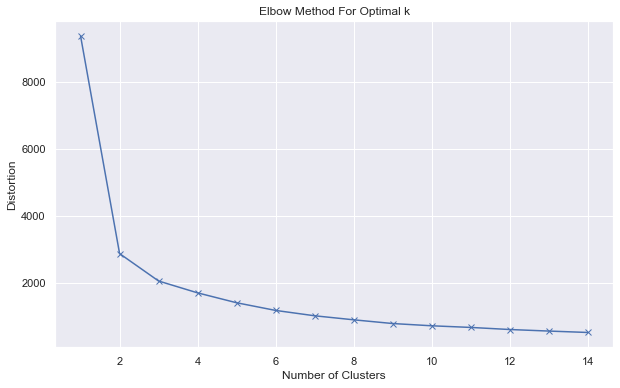

In [170]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Calculate distortions (inertia) for a range of cluster numbers
distortions = []
K = range(1, 15)  # Try different numbers of clusters
time_series_data = np.vstack([df.values for df in grouped_dict.values()])
for k in K:
    kmeanModel = KMeans(n_clusters=k, random_state=0)
    kmeanModel.fit(time_series_data)
    distortions.append(kmeanModel.inertia_)

# Plot the Elbow Method graph
plt.figure(figsize=(10, 6))
plt.plot(K, distortions, 'bx-')
plt.xlabel('Number of Clusters')
plt.ylabel('Distortion')
plt.title('Elbow Method For Optimal k')
plt.show()


Scree plot is plotting the sum of squared distances (inertia) for a range of cluster numbers. The "elbow" of the plot is a point where the rate of decrease sharply changes. This can be a good indication of the optimal number of clusters

The number of clusters for our data is 3

0.756 --> 0.548 --> 0.542 --> 0.541 --> 0.540 --> 0.540 --> 0.540 --> 0.540 --> 0.540 --> 0.540 --> 


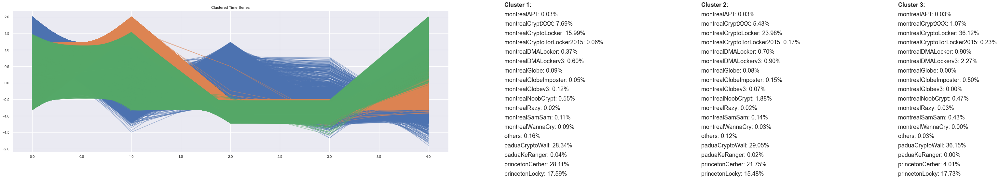

In [171]:
import numpy as np
import matplotlib.pyplot as plt
from tslearn.clustering import TimeSeriesKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

# Load and preprocess data
time_series_data = np.vstack([df.values for df in grouped_dict.values()])
X_train = TimeSeriesScalerMeanVariance().fit_transform(time_series_data)

# Apply TimeSeriesKMeans
n_clusters = 3
km = TimeSeriesKMeans(n_clusters=n_clusters, metric="euclidean", verbose=True, random_state=0)
y_pred = km.fit_predict(X_train)

# Create a dictionary to map labels to unique integers
label_mapping = {label: idx for idx, label in enumerate(grouped_dict.keys())}

# Match labels with cluster labels
labels = []
for label, df in grouped_dict.items():
    num_samples = len(df)
    labels.extend([label_mapping[label]] * num_samples)

# Count occurrences of each label in each cluster
cluster_label_counts = np.zeros((n_clusters, len(set(labels))))
for cluster_idx in range(n_clusters):
    cluster_samples = np.array(labels)[y_pred == cluster_idx]
    unique_labels, label_counts = np.unique(cluster_samples, return_counts=True)
    cluster_label_counts[cluster_idx, unique_labels.astype(int)] = label_counts

# Plot clustered time series
plt.figure(figsize=(24, 8))  # Increased figure size

for cluster_idx in range(n_clusters):
    cluster_samples = X_train[y_pred == cluster_idx]
    
    for sample_idx in range(cluster_samples.shape[0]):
        plt.plot(cluster_samples[sample_idx].ravel(), color=f'C{cluster_idx}', alpha=0.5)
    
    # Plot cluster center
    cluster_center = km.cluster_centers_[cluster_idx]
    plt.plot(cluster_center.ravel(), color=f'C{cluster_idx}', linewidth=2)

    # Display cluster percentage of labels
    cluster_percentage = cluster_label_counts[cluster_idx] / np.sum(cluster_label_counts[cluster_idx]) * 100
    
    # Position text outside the graph
    text_x = 1.0 + cluster_idx * 0.35
    text_y = 0.9  # Adjusted vertical position
    
    # Display cluster number with larger font
    plt.text(text_x, text_y, f'Cluster {cluster_idx+1}:', transform=plt.gcf().transFigure, fontsize=18, fontweight='bold')
    
    # Display details for each label with larger font
    for label_idx, percentage in enumerate(cluster_percentage):
        label_name = list(label_mapping.keys())[list(label_mapping.values()).index(label_idx)]
        plt.text(text_x, text_y - 0.05 * (label_idx + 1), f'{label_name}: {percentage:.2f}%', transform=plt.gcf().transFigure, fontsize=18)

plt.title('Clustered Time Series')
plt.show()


From the 3 clusters of timeseries data, we see that the label paduaCryptoWall, pricetonCerber dominate at 28.34% and 28.11%, in cluster 2 montrealCryptolocker, paduaCryptoWall and pricetonCerber dominate at 23.98%,29.06% and 21.75% showing similar characters at the timeframe and cluster 3 montrealCryptolocker and paduaCryptoWall dominate at 36.12% and 36.15% all the other ransomware labels.

In [173]:

from sklearn.metrics import silhouette_samples
# Flatten the time series data
X_train_flat = X_train.reshape(X_train.shape[0], -1)

# Calculate silhouette score
silhouette_avg = silhouette_score(X_train_flat, y_pred, metric="euclidean")
print(f"Silhouette Score: {silhouette_avg}")

Silhouette Score: 0.6625682054130737


Silhouette Score: The silhouette score is a measure of how similar an object is to its own cluster (cohesion) compared to other clusters (separation). The score ranges from -1 to 1, where a high value indicates that the object is well matched to its own cluster and poorly matched to neighboring clusters. In your case, a silhouette score of approximately 0.46 suggests a reasonable level of separation between the clusters.

A score near +1 indicates that the sample is far away from the neighboring clusters, which is good.
A score of 0 indicates that the sample is on or very close to the decision boundary between two neighboring clusters.
A score near -1 indicates that those samples might have been assigned to the wrong cluster.
Inertia: Inertia, also known as within-cluster sum of squares, is a measure of how internally coherent the clusters are. It is calculated as the sum of squared distances of samples to their closest cluster center. A lower inertia indicates that the clusters are more tightly packed and therefore likely to be more meaningful.

Inertia tends to decrease as the number of clusters increases. However, at a certain point, the decrease in inertia becomes marginal, indicating that adding more clusters doesn't significantly improve the quality of the clustering.
In your case, a low inertia value of approximately 0.042 suggests that the clusters are fairly tightly packed around their respective cluster centers.

Overall, a silhouette score of around 0.46 and a low inertia value of approximately 0.042 indicate that the clustering is reasonably good, but it's important to note that the interpretation of these metrics depends on the specific context of your data and the problem you're trying to solve. It's recommended to also visually inspect the clusters and potentially validate them through domain knowledge or other evaluation techniques.







In [174]:
df2 = pd.read_csv('Bitcoin Historical Data.csv')

In [175]:
df2.head(5)

,Date,Price,Open,High,Low,Vol.,Change %
0,"Aug 12, 2023","29,412.8","29,420.8","29,455.8","29,375.4",23.90K,-0.03%
1,"Aug 11, 2023","29,420.8","29,448.9","29,544.9","29,271.2",27.71K,-0.10%
2,"Aug 10, 2023","29,449.0","29,578.0","29,719.4","29,377.5",32.00K,-0.44%
3,"Aug 09, 2023","29,578.0","29,771.3","30,104.0","29,384.2",49.67K,-0.67%
4,"Aug 08, 2023","29,777.4","29,204.2","30,168.6","29,137.7",62.57K,1.96%


In [176]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4607 entries, 0 to 4606
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Date      4607 non-null   object
 1   Price     4607 non-null   object
 2   Open      4607 non-null   object
 3   High      4607 non-null   object
 4   Low       4607 non-null   object
 5   Vol.      4607 non-null   object
 6   Change %  4607 non-null   object
dtypes: object(7)
memory usage: 252.1+ KB


In [177]:
df2['Date'] = df2['Date'].astype('datetime64[ns]')

In [178]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4607 entries, 0 to 4606
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Date      4607 non-null   datetime64[ns]
 1   Price     4607 non-null   object        
 2   Open      4607 non-null   object        
 3   High      4607 non-null   object        
 4   Low       4607 non-null   object        
 5   Vol.      4607 non-null   object        
 6   Change %  4607 non-null   object        
dtypes: datetime64[ns](1), object(6)
memory usage: 252.1+ KB


In [179]:
df2['Price']=df2['Price'].str.replace(',', '')

In [180]:
df2['Price'] = df2['Price'].astype(float)


In [181]:
df2 = df2.drop(['Open','High','Low','Vol.','Change %'], axis=1)

In [182]:
df2.dtypes

Date     datetime64[ns]
Price           float64
dtype: object

In [183]:
df2['Price'].describe()

count     4607.000000
mean      9773.610636
std      14808.120079
min          0.300000
25%        236.200000
50%       1264.300000
75%      11166.250000
max      67527.900000
Name: Price, dtype: float64

In [184]:
df2.Price.isnull()

0       False
1       False
2       False
3       False
4       False
        ...  
4602    False
4603    False
4604    False
4605    False
4606    False
Name: Price, Length: 4607, dtype: bool

In [185]:
df2.set_index('Date', inplace=True)

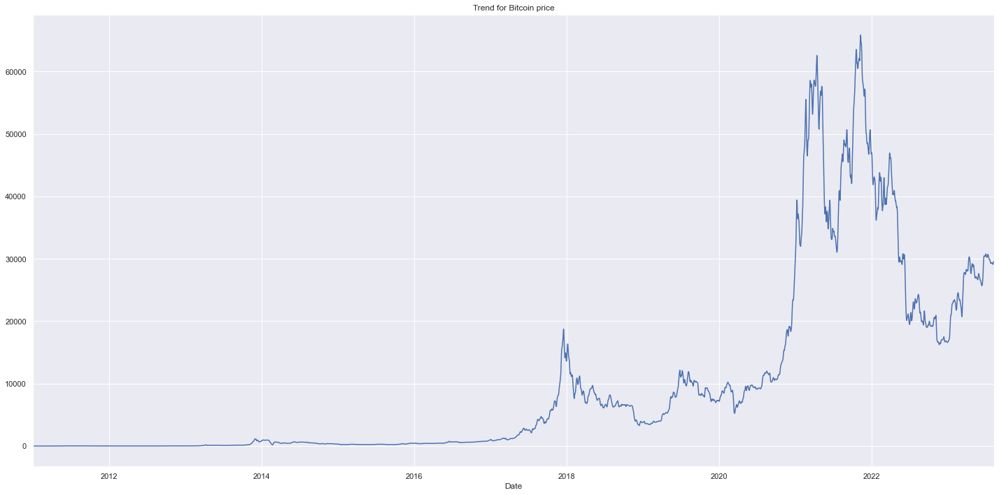

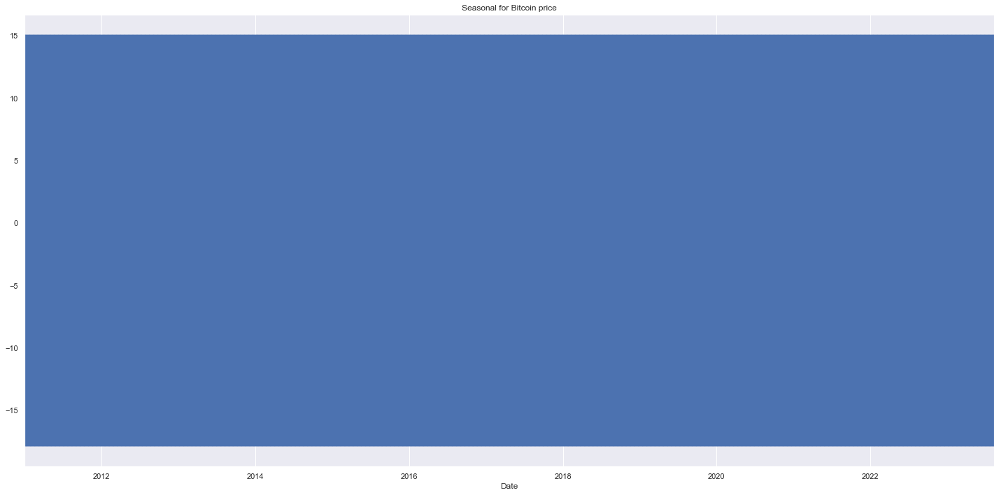

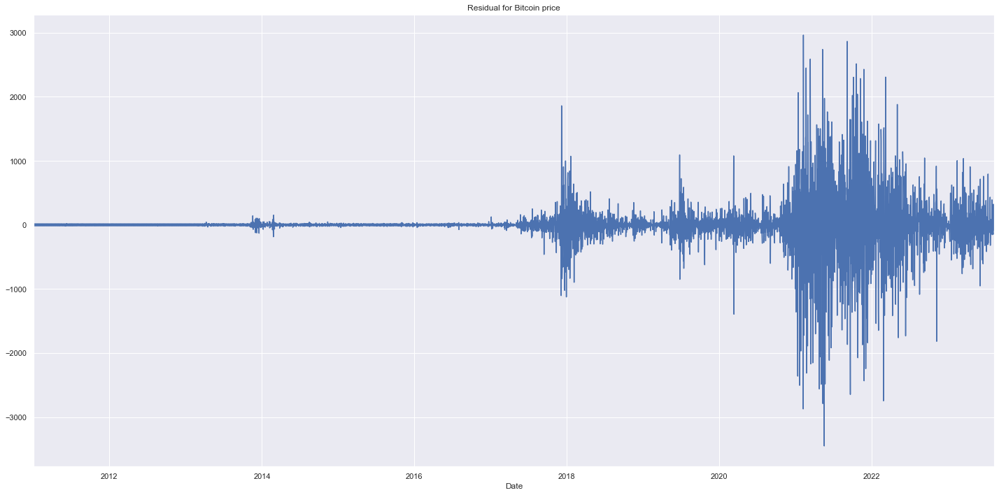

In [186]:
seasonal_period = 4

series = df2['Price']
result = seasonal_decompose(series, model='additive', period=seasonal_period)

# Plotting Trend
ax1 = result.trend.plot()
ax1.set_title(f'Trend for Bitcoin price')

plt.tight_layout()
plt.show()
# Plotting Seasonal
ax2 = result.seasonal.plot()
ax2.set_title(f'Seasonal for Bitcoin price')
plt.tight_layout()
plt.show()
# Plotting Residual
ax3 = result.resid.plot()
ax3.set_title(f'Residual for Bitcoin price')

plt.tight_layout()
plt.show()

In [187]:
df_ransomware = pd.merge(df_old, df2 , on='Date')

In [188]:
df_ransomware.head()

,Date,length,weight,count,looped,income,label,Price
0,2011-01-01,34,0.515627,2,1,3.900000e+07,white,0.3
1,2011-01-01,30,0.000015,1,0,4.200000e+07,white,0.3
2,2011-01-01,10,0.015625,1,0,4.670000e+09,white,0.3
3,2011-01-01,10,0.015625,1,0,2.230000e+08,white,0.3
4,2011-01-01,14,0.324619,20,0,4.310000e+09,white,0.3


In [189]:
df_ransomware.describe()

,length,weight,count,looped,income,Price
count,918545.000000,9.185450e+05,918545.000000,918545.000000,9.185450e+05,918545.000000
mean,25.698234,3.896156e-01,160.166409,31.211616,1.054347e+09,54.886091
std,42.528946,4.242873e-01,601.009973,265.055766,1.426300e+09,143.305674
min,0.000000,3.610000e-94,1.000000,0.000000,3.000000e+07,0.300000
25%,0.000000,1.874507e-02,1.000000,0.000000,1.008936e+08,4.900000
50%,4.000000,2.500000e-01,1.000000,0.000000,3.450000e+08,10.900000
75%,26.000000,5.000000e-01,8.000000,0.000000,1.430000e+09,64.500000
max,144.000000,2.499818e+00,8120.000000,8073.000000,6.111050e+09,15416.600000


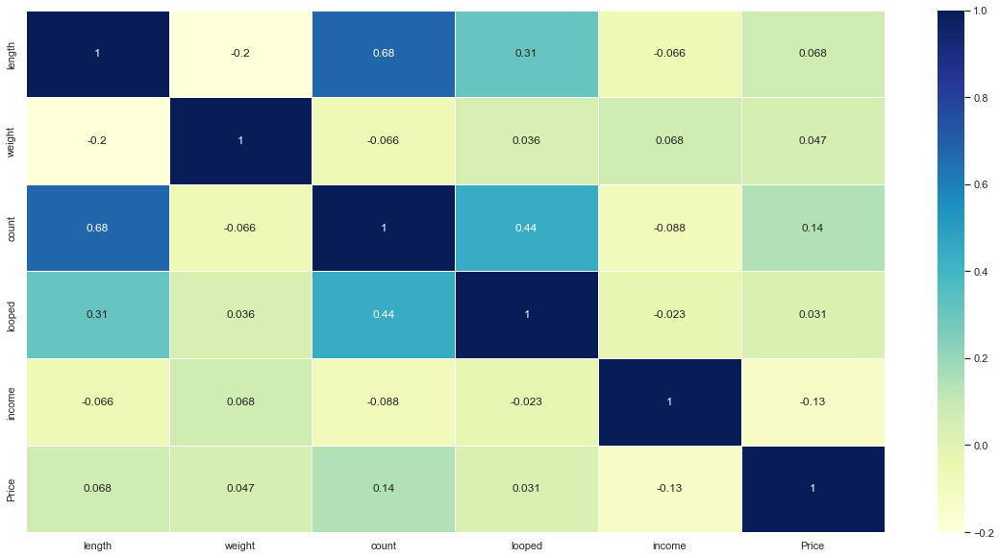

In [190]:
ax = sns.heatmap(df_ransomware.corr(method='pearson'), cmap="YlGnBu",annot=True,linewidth =1)

In [191]:
df_ransomware[['length','weight','count','looped','income','Price']] = scaler.fit_transform(df_ransomware[['length','weight','count','looped','income','Price']])


In [192]:
df_ransomware.describe()

,length,weight,count,looped,income,Price
count,918545.000000,918545.000000,918545.000000,918545.000000,918545.000000,918545.000000
mean,0.178460,0.155858,0.019604,0.003866,0.168449,0.003541
std,0.295340,0.169727,0.074025,0.032832,0.234548,0.009296
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.007499,0.000000,0.000000,0.011658,0.000298
50%,0.027778,0.100007,0.000000,0.000000,0.051800,0.000688
75%,0.180556,0.200015,0.000862,0.000000,0.230223,0.004164
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [193]:
group1 = df_ransomware.groupby('label')

In [194]:
grouped_dict_price = {}

# Iterate through the groups and store them in the dictionary
for label, group in group1:
    grouped_dict_price[label] = group
grouped_dict_price

{'montrealAPT':              Date    length    weight     count    looped    income  \
 911398 2016-09-15  0.013889  0.600044  0.000123  0.000000  0.007317   
 912064 2016-09-27  0.041667  0.050004  0.000000  0.000000  0.011511   
 912371 2016-10-03  0.000000  0.200015  0.000000  0.000000  0.004464   
 912386 2016-10-04  1.000000  0.123900  0.601182  0.000000  0.159512   
 914614 2016-12-10  1.000000  0.480763  0.335509  0.000000  0.025982   
 915217 2017-01-05  0.041667  0.200015  0.000000  0.000000  0.025982   
 916249 2017-02-15  1.000000  0.069887  0.475182  0.000000  0.041440   
 916911 2017-03-17  1.000000  0.550041  0.994581  1.000000  0.089242   
 917183 2017-03-31  0.055556  0.125009  0.000000  0.000124  0.174082   
 918539 2017-11-30  1.000000  0.047837  0.365439  0.000000  0.019733   
 918540 2017-12-01  0.013889  0.666715  0.000000  0.000124  0.059354   
 
               label     Price  
 911398  montrealAPT  0.039426  
 912064  montrealAPT  0.039257  
 912371  montrealAPT

In [195]:
keys = []
for key in grouped_dict_price:
    keys.append(key)

keys

['montrealAPT',
 'montrealCryptXXX',
 'montrealCryptoLocker',
 'montrealCryptoTorLocker2015',
 'montrealDMALocker',
 'montrealDMALockerv3',
 'montrealGlobe',
 'montrealGlobeImposter',
 'montrealGlobev3',
 'montrealNoobCrypt',
 'montrealRazy',
 'montrealSamSam',
 'montrealWannaCry',
 'others',
 'paduaCryptoWall',
 'paduaKeRanger',
 'princetonCerber',
 'princetonLocky',
 'white']

In [196]:
for key, df in grouped_dict_price.copy().items():
    if key == 'white':
        del grouped_dict_price[key]

In [197]:
columns_to_remove1 = ['Date', 'label']

# Dictionary to store removed columns
removed_columns_dict1 = {}

# Step 1: Create a copy of the columns to remove
for key, df in grouped_dict_price.items():
    removed_columns_dict1[key] = df[columns_to_remove1].copy()

# Step 2: Remove the columns from the DataFrames
for key, df in grouped_dict_price.items():
    df.drop(columns=columns_to_remove1, inplace=True)

# Step 3: Store the removed columns for later use
for key, removed_columns in removed_columns_dict1.items():
    print(f"Removed columns for {key}:")
    print(removed_columns)
    print('-' * 20)

# Print the modified DataFrames
for key, df in grouped_dict_price.items():
    print(f"DataFrame for {key}:")
    print(df)
    print('-' * 20)

Removed columns for montrealAPT:
             Date        label
911398 2016-09-15  montrealAPT
912064 2016-09-27  montrealAPT
912371 2016-10-03  montrealAPT
912386 2016-10-04  montrealAPT
914614 2016-12-10  montrealAPT
915217 2017-01-05  montrealAPT
916249 2017-02-15  montrealAPT
916911 2017-03-17  montrealAPT
917183 2017-03-31  montrealAPT
918539 2017-11-30  montrealAPT
918540 2017-12-01  montrealAPT
--------------------
Removed columns for montrealCryptXXX:
             Date             label
904857 2016-05-11  montrealCryptXXX
904867 2016-05-12  montrealCryptXXX
904868 2016-05-12  montrealCryptXXX
904871 2016-05-12  montrealCryptXXX
904873 2016-05-12  montrealCryptXXX
...           ...               ...
911796 2016-09-22  montrealCryptXXX
911954 2016-09-26  montrealCryptXXX
911996 2016-09-26  montrealCryptXXX
912221 2016-09-30  montrealCryptXXX
912547 2016-10-06  montrealCryptXXX

[2400 rows x 2 columns]
--------------------
Removed columns for montrealCryptoLocker:
             Dat

In [198]:
grouped_dict_price

{'montrealAPT':           length    weight     count    looped    income     Price
 911398  0.013889  0.600044  0.000123  0.000000  0.007317  0.039426
 912064  0.041667  0.050004  0.000000  0.000000  0.011511  0.039257
 912371  0.000000  0.200015  0.000000  0.000000  0.004464  0.039653
 912386  1.000000  0.123900  0.601182  0.000000  0.159512  0.039484
 914614  1.000000  0.480763  0.335509  0.000000  0.025982  0.050187
 915217  0.041667  0.200015  0.000000  0.000000  0.025982  0.064153
 916249  1.000000  0.069887  0.475182  0.000000  0.041440  0.065379
 916911  1.000000  0.550041  0.994581  1.000000  0.089242  0.069498
 917183  0.055556  0.125009  0.000000  0.000124  0.174082  0.069978
 918539  1.000000  0.047837  0.365439  0.000000  0.019733  0.645194
 918540  0.013889  0.666715  0.000000  0.000124  0.059354  0.704527,
 'montrealCryptXXX':           length    weight     count  looped    income     Price
 904857  1.000000  0.025727  0.372090     0.0  0.014800  0.029333
 904867  0.12500

In [199]:
columns_to_add = ['Date']
for key, g_df in grouped_dict_price.items():
    for column in columns_to_add:
        g_df[column] = removed_columns_dict[key][column].values

# Print the PCA result DataFrames after adding back the columns
for key, g_df in grouped_dict_price.items():
    print(f"Result DataFrame for {key}:")
    print(g_df)
    print('-' * 20)

Result DataFrame for montrealAPT:
          length    weight     count    looped    income     Price       Date
911398  0.013889  0.600044  0.000123  0.000000  0.007317  0.039426 2016-09-15
912064  0.041667  0.050004  0.000000  0.000000  0.011511  0.039257 2016-09-27
912371  0.000000  0.200015  0.000000  0.000000  0.004464  0.039653 2016-10-03
912386  1.000000  0.123900  0.601182  0.000000  0.159512  0.039484 2016-10-04
914614  1.000000  0.480763  0.335509  0.000000  0.025982  0.050187 2016-12-10
915217  0.041667  0.200015  0.000000  0.000000  0.025982  0.064153 2017-01-05
916249  1.000000  0.069887  0.475182  0.000000  0.041440  0.065379 2017-02-15
916911  1.000000  0.550041  0.994581  1.000000  0.089242  0.069498 2017-03-17
917183  0.055556  0.125009  0.000000  0.000124  0.174082  0.069978 2017-03-31
918539  1.000000  0.047837  0.365439  0.000000  0.019733  0.645194 2017-11-30
918540  0.013889  0.666715  0.000000  0.000124  0.059354  0.704527 2017-12-01
--------------------
Result Da

In [200]:
for label, g_df in grouped_dict_price.items():
    g_df.set_index('Date', inplace=True)

In [201]:
for label, g_df in grouped_dict_price.items():
    print(f"Results for {label}:")
    print(g_df)
    print('-' * 20)

Results for montrealAPT:
              length    weight     count    looped    income     Price
Date                                                                  
2016-09-15  0.013889  0.600044  0.000123  0.000000  0.007317  0.039426
2016-09-27  0.041667  0.050004  0.000000  0.000000  0.011511  0.039257
2016-10-03  0.000000  0.200015  0.000000  0.000000  0.004464  0.039653
2016-10-04  1.000000  0.123900  0.601182  0.000000  0.159512  0.039484
2016-12-10  1.000000  0.480763  0.335509  0.000000  0.025982  0.050187
2017-01-05  0.041667  0.200015  0.000000  0.000000  0.025982  0.064153
2017-02-15  1.000000  0.069887  0.475182  0.000000  0.041440  0.065379
2017-03-17  1.000000  0.550041  0.994581  1.000000  0.089242  0.069498
2017-03-31  0.055556  0.125009  0.000000  0.000124  0.174082  0.069978
2017-11-30  1.000000  0.047837  0.365439  0.000000  0.019733  0.645194
2017-12-01  0.013889  0.666715  0.000000  0.000124  0.059354  0.704527
--------------------
Results for montrealCryptXXX:
 

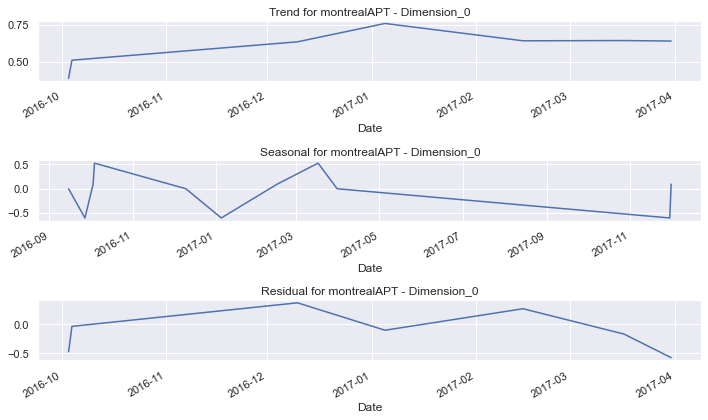

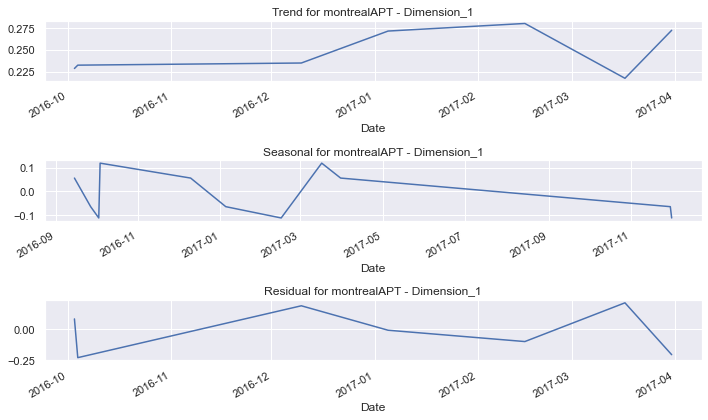

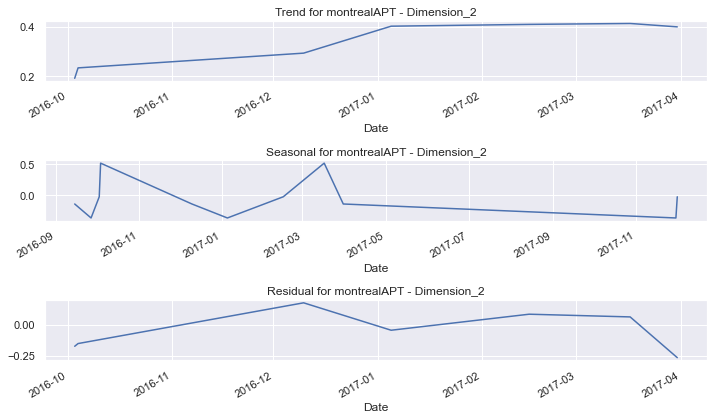

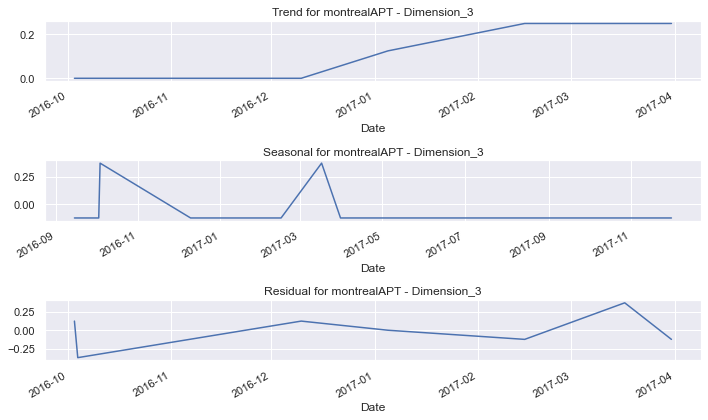

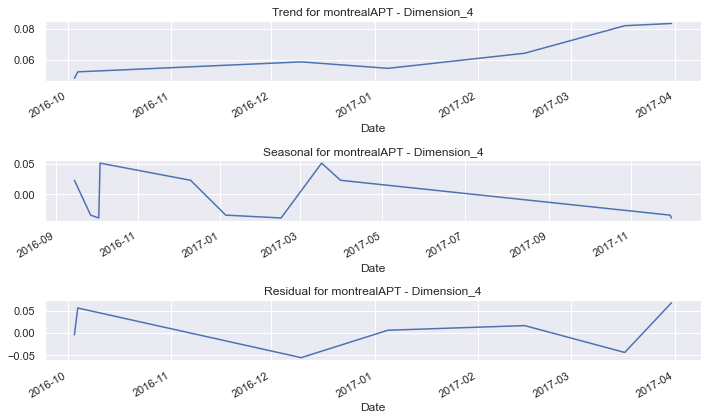

...

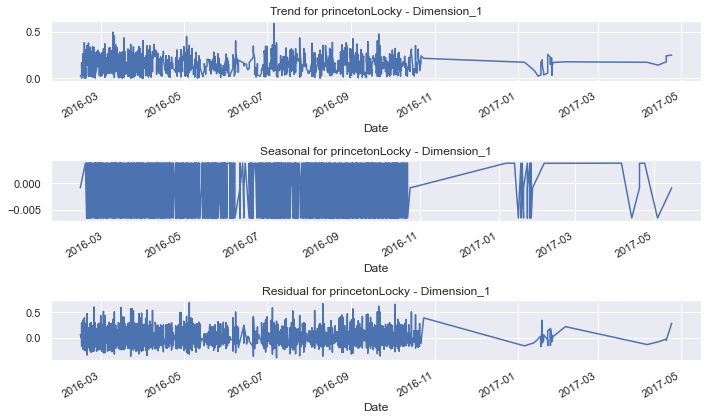

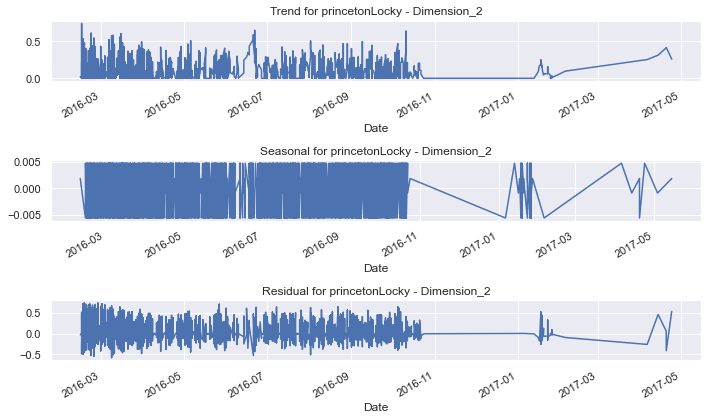

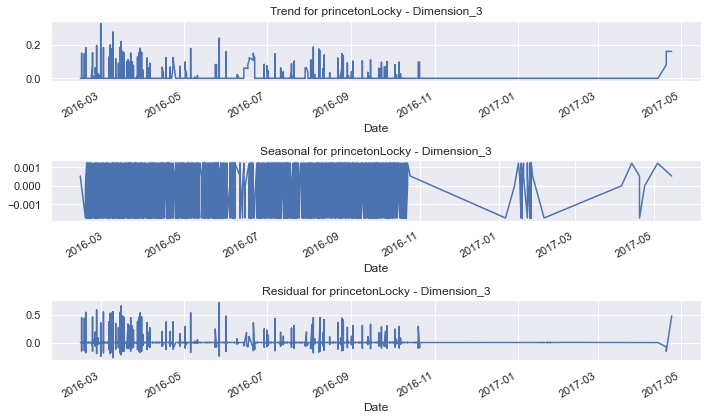

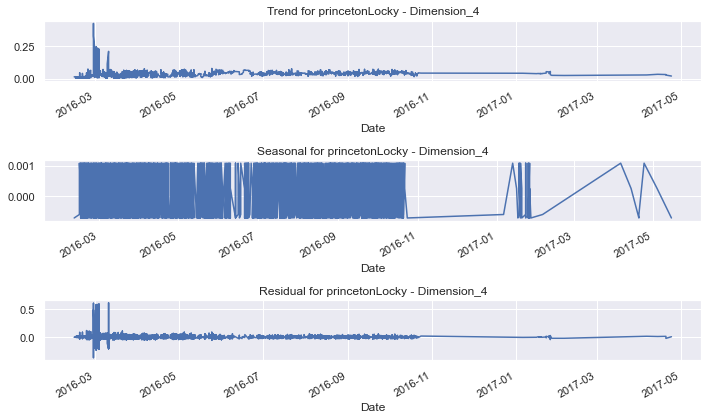

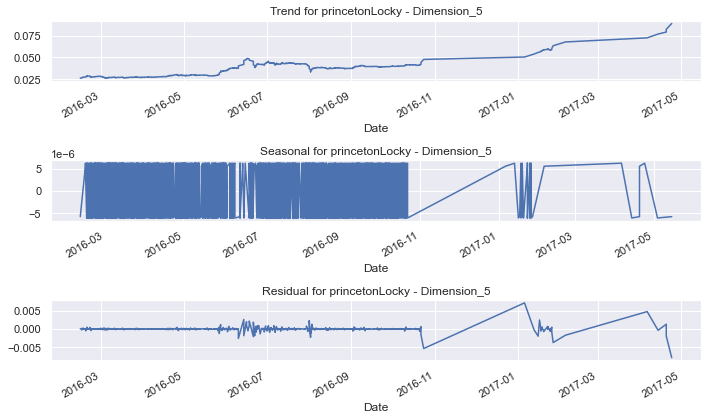

In [202]:
from statsmodels.tsa.seasonal import seasonal_decompose

# Assuming you have a DataFrame 'df' and 'column_name' is the column you want to process
seasonal_period = 4  # Adjust based on your data

for key, data in grouped_dict_price.items():
    df = pd.DataFrame(data)
    df.columns = [f'Dimension_{i}' for i in range(df.shape[1])]  # Rename columns for clarity

    for col in df.columns:
        series = df[col]
        result = seasonal_decompose(series, model='additive', period=seasonal_period)

        fig, axes = plt.subplots(3, 1, figsize=(10, 6))

        # Plotting Trend
        result.trend.plot(ax=axes[0])
        axes[0].set_title(f'Trend for {key} - {col}')

        # Plotting Seasonal
        result.seasonal.plot(ax=axes[1])
        axes[1].set_title(f'Seasonal for {key} - {col}')

        # Plotting Residual
        result.resid.plot(ax=axes[2])
        axes[2].set_title(f'Residual for {key} - {col}')

        plt.tight_layout()
        plt.show()


In [203]:
from statsmodels.tsa.stattools import adfuller

# Function to perform ADF test and return results
def perform_adf_test1(label, df, column):
    series = df[column]
    result = adfuller(series)
    adf_statistic = result[0]
    p_value = result[1]
    critical_values = result[4]
    stationary = p_value <= 0.05
    return {
        'ADF Statistic': adf_statistic,
        'p-value': p_value,
        'Critical Values': critical_values,
        'Stationary': stationary
    }

# Assuming you have a dictionary called 'pca_results_dict'
adf_results_dict1 = {}

# Apply ADF test without multiprocessing
for label, df in grouped_dict_price.items():
    for column in df.columns:
        result = perform_adf_test1(label, df, column)
        adf_results_dict1[label] = result

C:\Users\srivi\anaconda3\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2


In [204]:
for label, results in adf_results_dict1.items():
    print(f'Label: {label}')
    print(f'ADF Statistic: {results["ADF Statistic"]}')
    print(f'p-value: {results["p-value"]}')
    print(f'Critical Values: {results["Critical Values"]}')
    print(f'Stationary: {results["Stationary"]}')
    print('-' * 30)

Label: montrealAPT
ADF Statistic: 6.42731141431975
p-value: 1.0
Critical Values: {'1%': -4.9386902332361515, '5%': -3.477582857142857, '10%': -2.8438679591836733}
Stationary: False
------------------------------
Label: montrealCryptXXX
ADF Statistic: -1.603529049789824
p-value: 0.4818204859163214
Critical Values: {'1%': -3.4330971078682406, '5%': -2.8627536314741575, '10%': -2.5674160674638107}
Stationary: False
------------------------------
Label: montrealCryptoLocker
ADF Statistic: -1.7575852096835067
p-value: 0.4017133374015255
Critical Values: {'1%': -3.4311255858897485, '5%': -2.8618827558191304, '10%': -2.5669524440427645}
Stationary: False
------------------------------
Label: montrealCryptoTorLocker2015
ADF Statistic: -1.112420042045714
p-value: 0.7100936067656582
Critical Values: {'1%': -3.5714715250448363, '5%': -2.922629480573571, '10%': -2.5993358475635153}
Stationary: False
------------------------------
Label: montrealDMALocker
ADF Statistic: -1.0491941785518901
p-value:

### The ADF test evaluates the following hypotheses:

Null Hypothesis (H0): The time series has a unit root, indicating that it is non-stationary. In other words, there is a presence of a stochastic trend.

Alternative Hypothesis (H1): The time series does not have a unit root, indicating that it is stationary. In other words, there is no stochastic trend.

Interpreting the results of an Augmented Dickey-Fuller (ADF) test involves understanding the ADF statistic, p-value, and critical values. These elements help you determine whether a time series is stationary or not.

#### ADF Statistic:

The ADF statistic is a negative number. The more negative it is, the stronger the evidence against the null hypothesis (that the time series has a unit root and is non-stationary).
More negative values indicate stronger evidence for stationarity.

#### Critical Values:

These are values at different confidence levels that serve as thresholds for determining whether to reject the null hypothesis.
Common confidence levels are 1%, 5%, and 10%. The ADF statistic should be compared to these critical values.

- ADF statistic < critical values: Strong evidence for stationarity.
- ADF statistic > critical values: Weak evidence for stationarity.

#### p-value:

- If p-value < chosen significance level (e.g., 0.05):
    - Reject the null hypothesis (H0).Strong evidence that the time series is stationary.
- If p-value > chosen significance level:
    - Fail to reject the null hypothesis. Weak evidence against stationarity, suggesting the time series may be non-stationary.

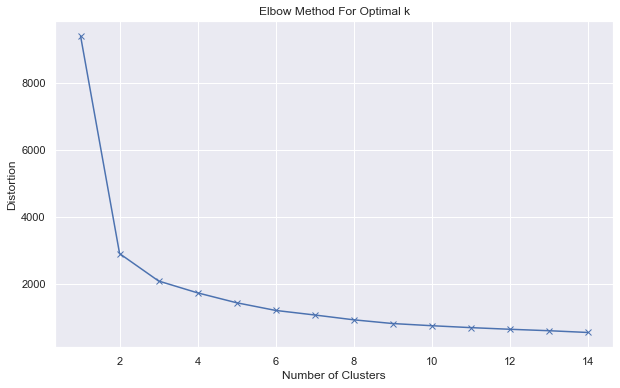

In [205]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Calculate distortions (inertia) for a range of cluster numbers
distortions1 = []
K = range(1, 15)  # Try different numbers of clusters
time_series_data1 = np.vstack([df.values for df in grouped_dict_price.values()])
for k in K:
    kmeanModel1 = KMeans(n_clusters=k, random_state=0)
    kmeanModel1.fit(time_series_data1)
    distortions1.append(kmeanModel1.inertia_)

# Plot the Elbow Method graph
plt.figure(figsize=(10, 6))
plt.plot(K, distortions1, 'bx-')
plt.xlabel('Number of Clusters')
plt.ylabel('Distortion')
plt.title('Elbow Method For Optimal k')
plt.show()


1.203 --> 0.988 --> 0.984 --> 0.983 --> 0.983 --> 0.983 --> 0.983 --> 0.983 --> 0.982 --> 0.982 --> 0.982 --> 


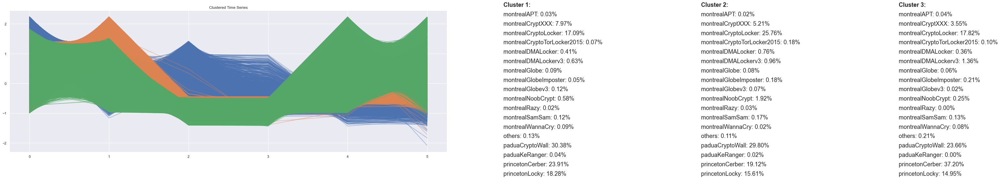

In [206]:
import numpy as np
import matplotlib.pyplot as plt
from tslearn.clustering import TimeSeriesKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

# Load and preprocess data
time_series_data1 = np.vstack([df.values for df in grouped_dict_price.values()])
X_train = TimeSeriesScalerMeanVariance().fit_transform(time_series_data1)

# Apply TimeSeriesKMeans
n_clusters = 3
km = TimeSeriesKMeans(n_clusters=n_clusters, metric="euclidean", verbose=True, random_state=0)
y_pred = km.fit_predict(X_train)

# Create a dictionary to map labels to unique integers
label_mapping = {label: idx for idx, label in enumerate(grouped_dict.keys())}

# Match labels with cluster labels
labels1 = []
for label, df in grouped_dict_price.items():
    num_samples = len(df)
    labels1.extend([label_mapping[label]] * num_samples)

# Count occurrences of each label in each cluster
cluster_label_counts = np.zeros((n_clusters, len(set(labels1))))
for cluster_idx in range(n_clusters):
    cluster_samples = np.array(labels1)[y_pred == cluster_idx]
    unique_labels, label_counts = np.unique(cluster_samples, return_counts=True)
    cluster_label_counts[cluster_idx, unique_labels.astype(int)] = label_counts

# Plot clustered time series
plt.figure(figsize=(24, 8))  # Increased figure size

for cluster_idx in range(n_clusters):
    cluster_samples = X_train[y_pred == cluster_idx]
    
    for sample_idx in range(cluster_samples.shape[0]):
        plt.plot(cluster_samples[sample_idx].ravel(), color=f'C{cluster_idx}', alpha=0.5)
    
    # Plot cluster center
    cluster_center = km.cluster_centers_[cluster_idx]
    plt.plot(cluster_center.ravel(), color=f'C{cluster_idx}', linewidth=2)

    # Display cluster percentage of labels
    cluster_percentage = cluster_label_counts[cluster_idx] / np.sum(cluster_label_counts[cluster_idx]) * 100
    
    # Position text outside the graph
    text_x = 1.0 + cluster_idx * 0.35
    text_y = 0.9  # Adjusted vertical position
    
    # Display cluster number with larger font
    plt.text(text_x, text_y, f'Cluster {cluster_idx+1}:', transform=plt.gcf().transFigure, fontsize=18, fontweight='bold')
    
    # Display details for each label with larger font
    for label_idx, percentage in enumerate(cluster_percentage):
        label_name = list(label_mapping.keys())[list(label_mapping.values()).index(label_idx)]
        plt.text(text_x, text_y - 0.05 * (label_idx + 1), f'{label_name}: {percentage:.2f}%', transform=plt.gcf().transFigure, fontsize=18)

plt.title('Clustered Time Series')
plt.show()

From the 3 clusters of timeseries data, we see that in cluster 1 - the label paduaCryptoWall dominates with increase from 28.34% to 30.38% followed by PricetonCerber at 23.91% , in cluster 2 - paduaCryptoWall dominates by increaing from 29.06% to 29.80% and closely followed by montrealCryptolocker increasing from 23.98% to 25.76% and showing similar characters at the timeframe and in cluster 3 - princetonCerber dominates increasing from from just 4.06% to 37.30% over all the other ransomware labels while montrealCryptolocker(36.12%) and paduaCryptoWall(36.15%) percentages decrease over all the other ransomware labels.

In [207]:
from sklearn.metrics import silhouette_score
from sklearn.metrics import silhouette_samples
# Flatten the time series data
X_train_flat = X_train.reshape(X_train.shape[0], -1)

# Calculate silhouette score
silhouette_avg = silhouette_score(X_train_flat, y_pred, metric="euclidean")
print(f"Silhouette Score: {silhouette_avg}")

Silhouette Score: 0.583950573053006


Though there is a bit of decrease in the Silhouette Score from 0.6 to 0.58, suggesting the clustering to be very distinct.

### Forecasting of timeseries data:

We try to forecast using three different models: VAR, SVM and LS-SVM

### VAR

In [314]:
# Fit the VAR model
model = VAR(time_series_data1)
model_fitted = model.fit()
forecast_dict = {}
# Loop through each DataFrame
for label, df in grouped_dict_price.items():
    # Forecasting for each DataFrame
    lag_order = model_fitted.k_ar
    forecast = model_fitted.forecast(df.values[-lag_order:], steps=10)
    forecast_df = pd.DataFrame(forecast, columns=df.columns, index=pd.date_range(start=df.index[-1], periods=11, freq='W')[1:])
    
    # Store the forecast in the dictionary
    forecast_dict[label] = forecast_df
    
# Print the forecasted values
for label, forecast_df in forecast_dict.items():
    print(f"Forecast for {label}:")
    print(forecast_df)


Forecast for montrealAPT:
            Dimension_0  Dimension_1  Dimension_2  Dimension_3  Dimension_4  \
2017-12-10     0.307295    -0.050387     0.183206     0.021314    -0.185693   
2017-12-17     0.340536    -0.134568     0.221305     0.018245    -0.205898   
2017-12-24     0.340492    -0.130663     0.220002     0.017235    -0.195693   
2017-12-31     0.336962    -0.113158     0.211843     0.016621    -0.181198   
2018-01-07     0.333149    -0.094326     0.202937     0.016099    -0.166759   
2018-01-14     0.329495    -0.076261     0.194371     0.015619    -0.153090   
2018-01-21     0.326060    -0.059274     0.186312     0.015172    -0.140269   
2018-01-28     0.322842    -0.043361     0.178761     0.014754    -0.128264   
2018-02-04     0.319830    -0.028466     0.171694     0.014363    -0.117028   
2018-02-11     0.317011    -0.014524     0.165079     0.013997    -0.106511   

            Dimension_5  
2017-12-10     0.660615  
2017-12-17     0.620442  
2017-12-24     0.582967  


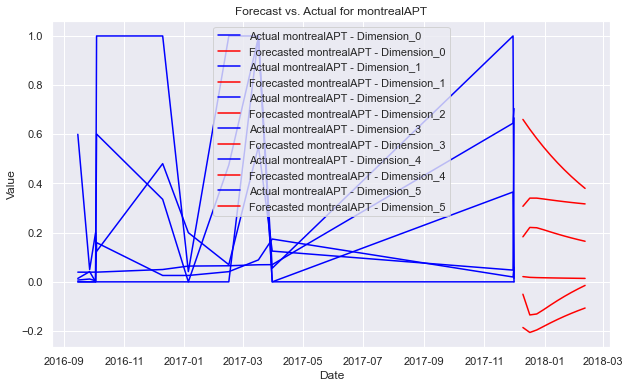

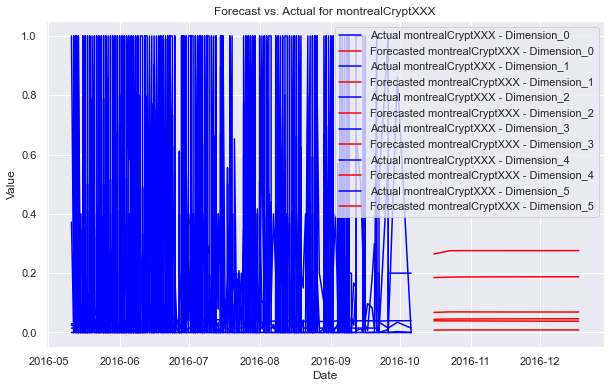

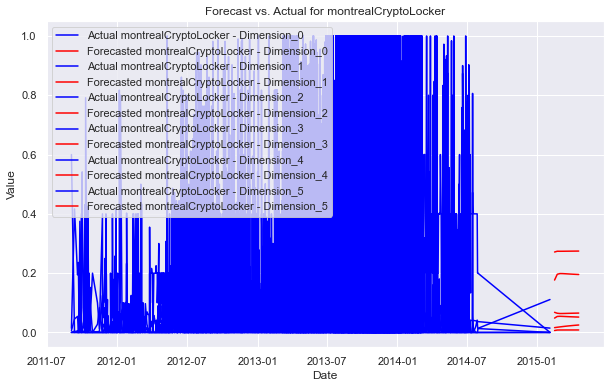

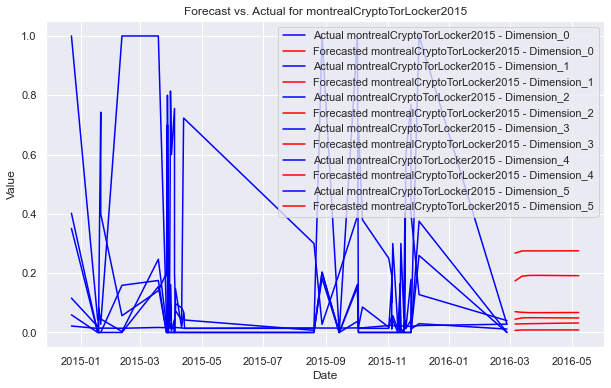

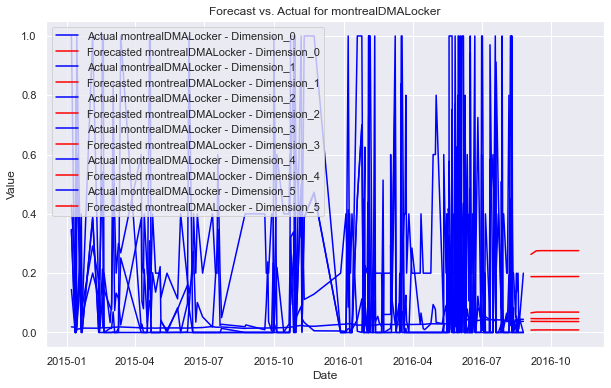

...

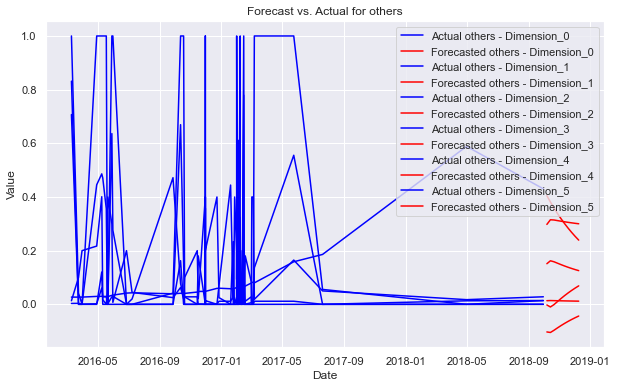

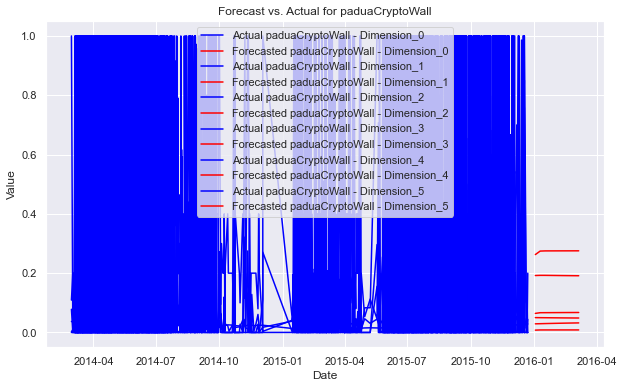

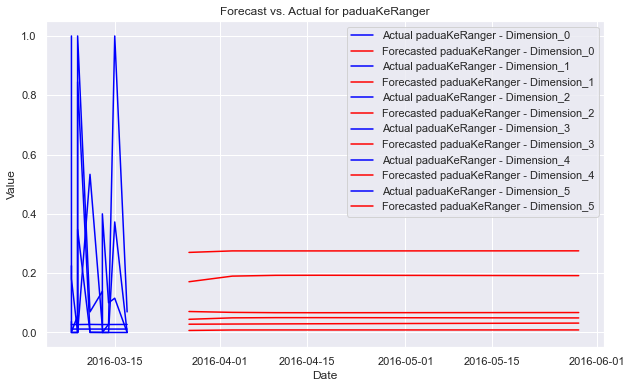

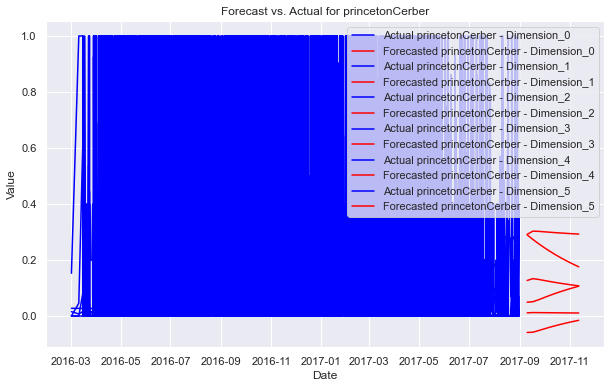

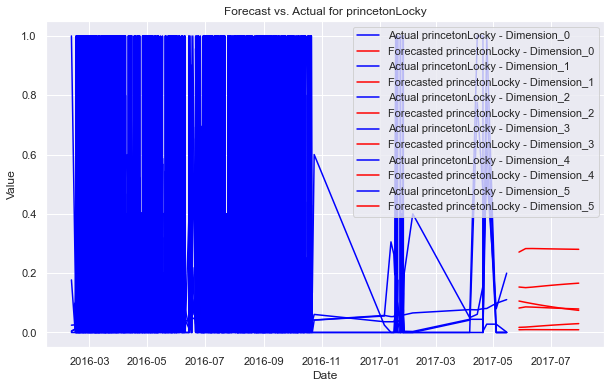

In [268]:

# Loop through each DataFrame
for label, df in grouped_dict_price.items():
    # Forecasting for each DataFrame
    lag_order = model_fitted.k_ar
    forecast = model_fitted.forecast(df.values[-lag_order:], steps=10)
    forecast_df = pd.DataFrame(forecast, columns=df.columns, index=pd.date_range(start=df.index[-1], periods=11, freq='W')[1:])
    
    # Plot the actual and forecasted values
    plt.figure(figsize=(10, 6))
    
    for column in df.columns:
        plt.plot(df.index, df[column], label=f'Actual {label} - {column}', color='blue')
        plt.plot(forecast_df.index, forecast_df[column], label=f'Forecasted {label} - {column}', color='red')

    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.title(f'Forecast vs. Actual for {label}')
    plt.legend()
    plt.show()


VAR is performed on the data for active forcasting, but may not be very accurate for multivariate timeseries data of ransomware attacks. We check MAE and RMSE to check the accuracy of forecast.

In [287]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Initialize lists to store evaluation results
mae_scores = []
rmse_scores = []

# Loop through each DataFrame
for label, df in grouped_dict_price.items():
    # Forecasting for each DataFrame
    lag_order = model_fitted.k_ar
    forecast = model_fitted.forecast(df.values[-lag_order:], steps=10)
    forecast_df = pd.DataFrame(forecast, columns=df.columns, index=pd.date_range(start=df.index[-1], periods=11, freq='W')[1:])
    
    # Extract the actual data for comparison
    actual_data = df.tail(6)
    
    # Calculate MAE and RMSE
    mae = mean_absolute_error(actual_data.values, forecast_df.values[:6])
    rmse = np.sqrt(mean_squared_error(actual_data.values, forecast_df.values[:6]))
    
    # Append results to lists
    mae_scores.append(mae)
    rmse_scores.append(rmse)

    # Print evaluation results for this DataFrame
    print(f'Evaluation for {label}:')
    print(f'MAE: {mae}')
    print(f'RMSE: {rmse}')
    print()

# Calculate overall evaluation metrics
overall_mae = np.mean(mae_scores)
overall_rmse = np.mean(rmse_scores)

# Print overall evaluation results
print(f'Overall MAE: {overall_mae}')
print(f'Overall RMSE: {overall_rmse}')


Evaluation for montrealAPT:
MAE: 0.33192806668628005
RMSE: 0.4133114582208901

Evaluation for montrealCryptXXX:
MAE: 0.10656242648031634
RMSE: 0.2043851993005007

Evaluation for montrealCryptoLocker:
MAE: 0.08288492382876604
RMSE: 0.12367987971982558

Evaluation for montrealCryptoTorLocker2015:
MAE: 0.1304082748380306
RMSE: 0.21200791526973264

Evaluation for montrealDMALocker:
MAE: 0.0683421242831827
RMSE: 0.11510797122205144

Evaluation for montrealDMALockerv3:
MAE: 0.14595715921386418
RMSE: 0.24594186007243946

Evaluation for montrealGlobe:
MAE: 0.08156810912925967
RMSE: 0.12283349974923996

Evaluation for montrealGlobeImposter:
MAE: 0.3430830597776214
RMSE: 0.4072500324688049

Evaluation for montrealGlobev3:
MAE: 0.18434367403876725
RMSE: 0.31352332397903526

Evaluation for montrealNoobCrypt:
MAE: 0.12490927411709873
RMSE: 0.2149449091962831

Evaluation for montrealRazy:
MAE: 0.22594765509683898
RMSE: 0.2831491884748911

Evaluation for montrealSamSam:
MAE: 0.14162162057697894
RMSE:

The MAE and RMSE are near zero for all the labels indication accuracy of forecast being high.

Using Support Vector Machines (SVMs) for time series forecasting depends on the specific characteristics of your data and your modeling objectives. Here are some considerations:

When to Use SVMs for Time Series Forecasting:

Complex Non-Linear Relationships: If your time series data exhibits complex non-linear relationships, SVMs with appropriate kernel functions (e.g., RBF kernel) can be effective in capturing these patterns.

When Other Models are Not Suitable: If your data does not meet the assumptions of traditional time series models like ARIMA or if the relationships are not linear, SVMs can be a viable alternative.

When Feature Engineering is Important: SVMs can be effective when you have a well-defined set of features that are meaningful in predicting the future values of your time series.

Small to Medium-Sized Datasets: SVMs can perform well with smaller datasets compared to some other machine learning models. If you have a limited amount of data, SVMs might be a good option.

When You Want to Avoid Overfitting: SVMs can be regularized effectively using parameters like C (penalty parameter). This can help prevent overfitting, especially in scenarios with noisy data.

When to Be Cautious with SVMs for Time Series Forecasting:

Interpretability: SVMs do not provide as straightforward interpretability as some other models like linear regression or decision trees. If interpretability is a critical factor, SVMs might not be the best choice.

Large Datasets: SVMs can be computationally intensive, especially for large datasets. For very large datasets, training times may be impractical.

Data Preprocessing: SVMs can be sensitive to the scale of the input features. It's important to properly preprocess the data, including scaling, before using SVMs.

Consider Alternative Approaches: Depending on the nature of your time series data, other specialized time series models like ARIMA, Exponential Smoothing, or Prophet may perform better.

Parameter Tuning: SVMs have several hyperparameters (e.g., choice of kernel, C, epsilon) that may require tuning. This can be time-consuming and may need to be performed carefully.

In summary, SVMs can be a viable option for time series forecasting, especially in cases of complex, non-linear relationships and when other models are not suitable. However, they may not always be the best choice, and it's important to carefully evaluate your data and modeling objectives before choosing SVMs for forecasting.






### SVR model

In [289]:
from sklearn.svm import SVR
from sklearn.multioutput import MultiOutputRegressor
from sklearn.preprocessing import StandardScaler

# Assuming you have a dictionary 'grouped_dict_price' where each value is a DataFrame
# Make sure your data is properly formatted

# Create SVR model
svr = SVR(kernel='rbf', C=1.0, epsilon=0.2)
mor = MultiOutputRegressor(svr)

# Standardize the data
scaler_X = StandardScaler()
scaler_y = StandardScaler()

for label, df in grouped_dict_price.items():
    # Prepare the features (X) and target (y) variables
    X = df[['Dimension_0', 'Dimension_1', 'Dimension_2','Dimension_3','Dimension_4','Dimension_5']]  # Include the relevant features
    y = df[['Dimension_0', 'Dimension_1', 'Dimension_2','Dimension_3','Dimension_4','Dimension_5']]   # Include the relevant targets

    # Standardize the data
    X_scaled = scaler_X.fit_transform(X)
    y_scaled = scaler_y.fit_transform(y)

    # Train the SVR model
    mor.fit(X_scaled, y_scaled)

    # Forecasting
    X_forecast = df[['Dimension_0', 'Dimension_1', 'Dimension_2','Dimension_3','Dimension_4','Dimension_5']]  # Include the relevant features
    X_forecast_scaled = scaler_X.transform(X_forecast)
    y_forecast_scaled = mor.predict(X_forecast_scaled)
    y_forecast = scaler_y.inverse_transform(y_forecast_scaled)

    # Create a DataFrame with the forecasted values
    forecast_df = pd.DataFrame(y_forecast, columns=y.columns, index=X_forecast.index)

    # Print the forecasted values
    print(f'Forecast for {label}:')
    print(forecast_df)


Forecast for montrealAPT:
            Dimension_0  Dimension_1  Dimension_2  Dimension_3  Dimension_4  \
Date                                                                          
2016-09-15     0.110928     0.554282     0.064152     0.057535     0.018768   
2016-09-27     0.138427     0.134867     0.063904     0.057398     0.022980   
2016-10-03     0.093051     0.239957     0.041882     0.051531     0.015914   
2016-10-04     0.903017     0.169771     0.537151     0.057587     0.122064   
2016-12-10     0.899818     0.434884     0.296675     0.057520     0.037473   
2017-01-05     0.085343     0.226009     0.029843     0.043626     0.022761   
2017-02-15     0.903262     0.115605     0.411221     0.054719     0.052878   
2017-03-17     0.903194     0.504317     0.617870     0.411702     0.077767   
2017-03-31     0.152316     0.170761     0.063947     0.057694     0.121182   
2017-11-30     0.903074     0.093674     0.301534     0.057520     0.031204   
2017-12-01     0.110782   

RMSE for montrealAPT: 0.11291474131359121


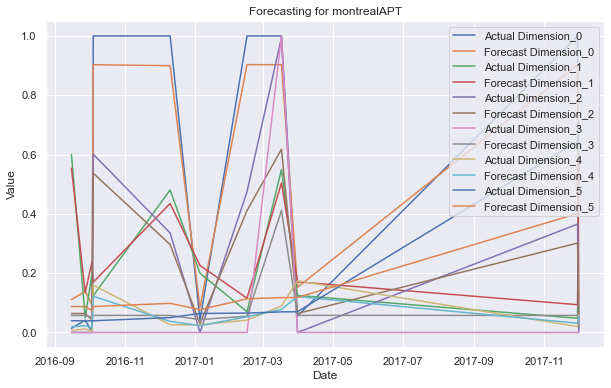

RMSE for montrealCryptXXX: 0.021026813509338965


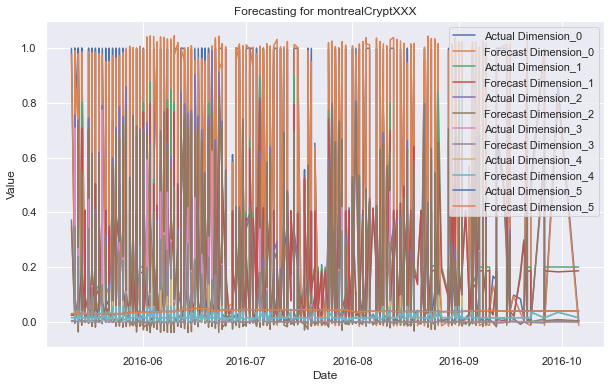

RMSE for montrealCryptoLocker: 0.020452649353066486


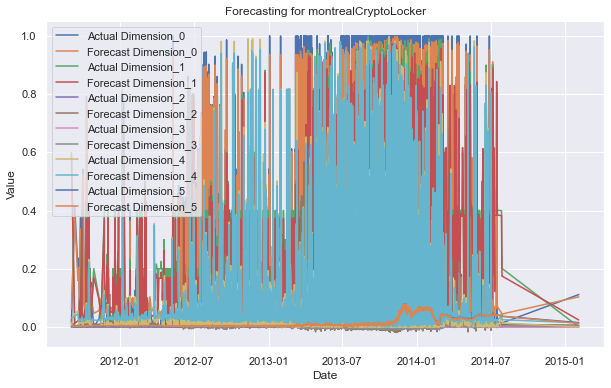

RMSE for montrealCryptoTorLocker2015: 0.04113919720255424


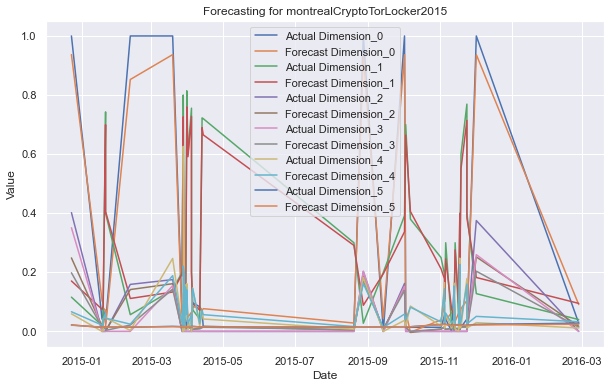

RMSE for montrealDMALocker: 0.03555865376880578


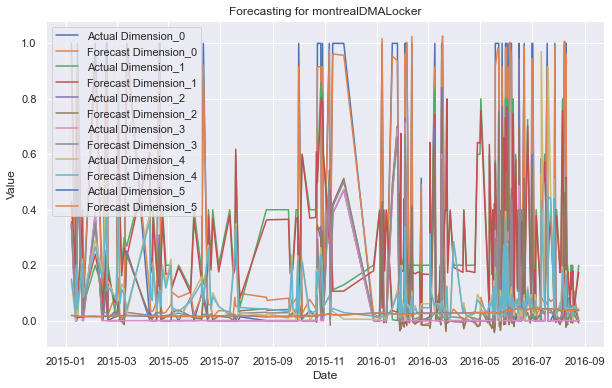

RMSE for montrealDMALockerv3: 0.031209628691085074


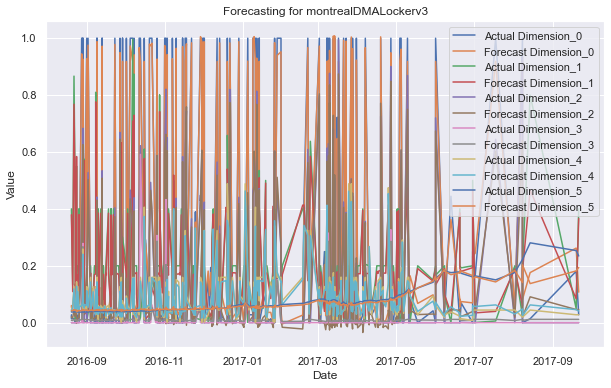

RMSE for montrealGlobe: 0.04820739928446997


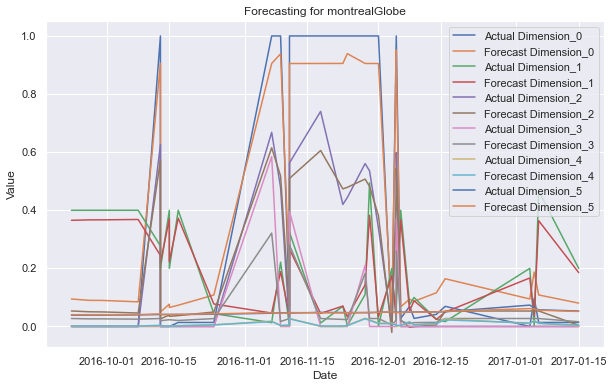

RMSE for montrealGlobeImposter: 0.06558607804699831


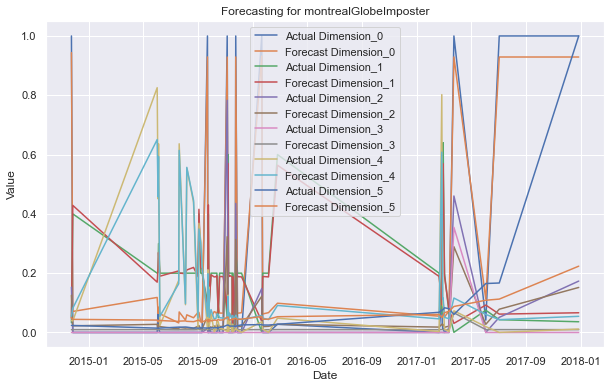

RMSE for montrealGlobev3: 0.05741374457269916


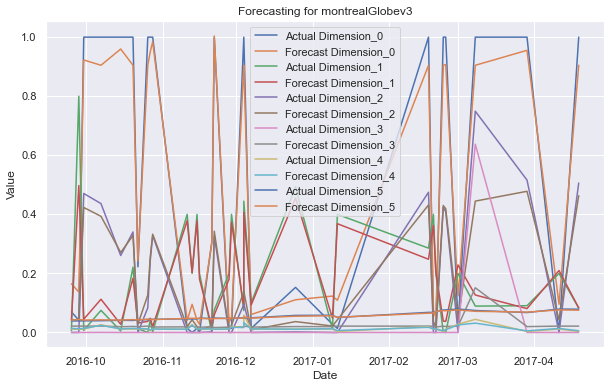

RMSE for montrealNoobCrypt: 0.027978379970543213


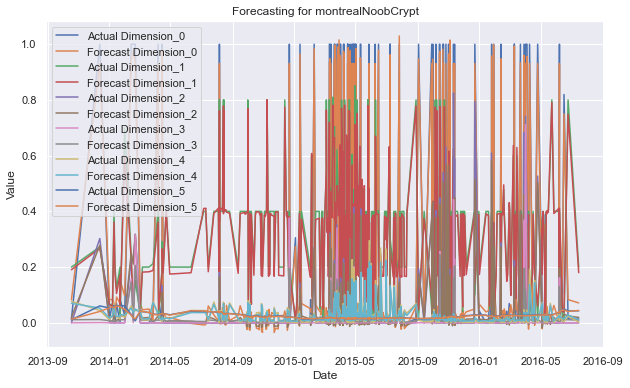

RMSE for montrealRazy: 0.09577472641583884


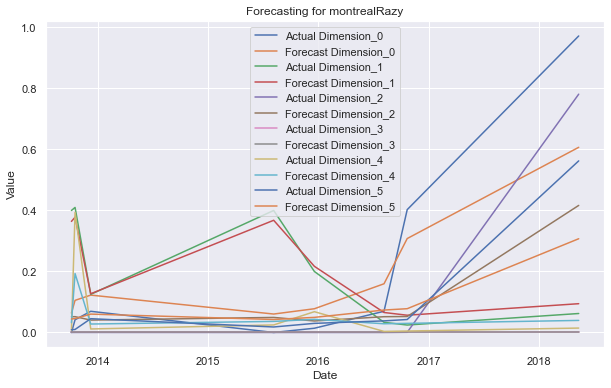

RMSE for montrealSamSam: 0.037598300637036064


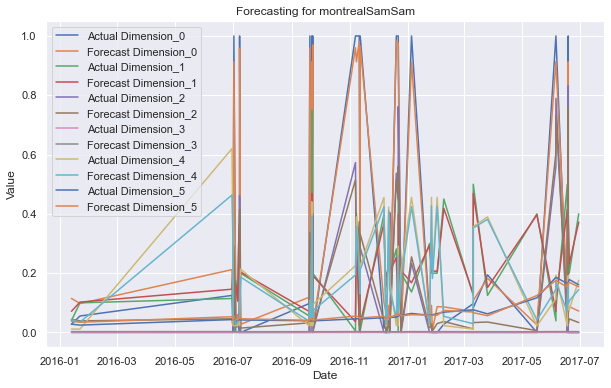

RMSE for montrealWannaCry: 0.06510395136041211


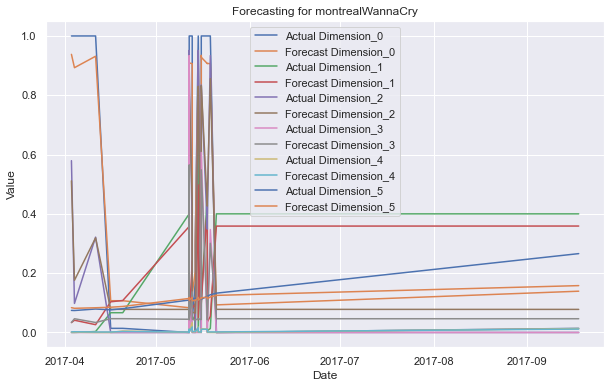

RMSE for others: 0.05876519626674443


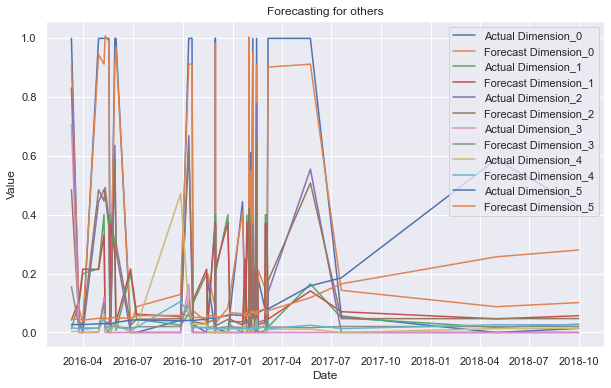

RMSE for paduaCryptoWall: 0.022215070870553542


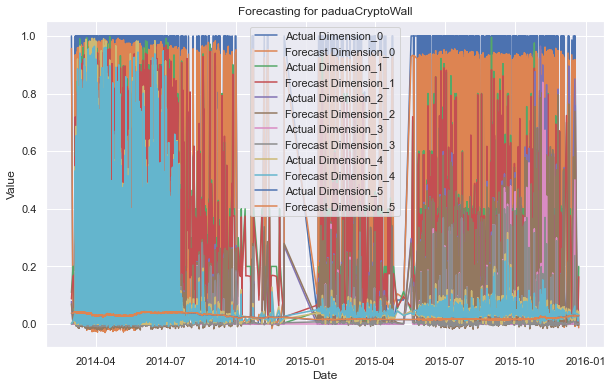

RMSE for paduaKeRanger: 0.07782753845971478


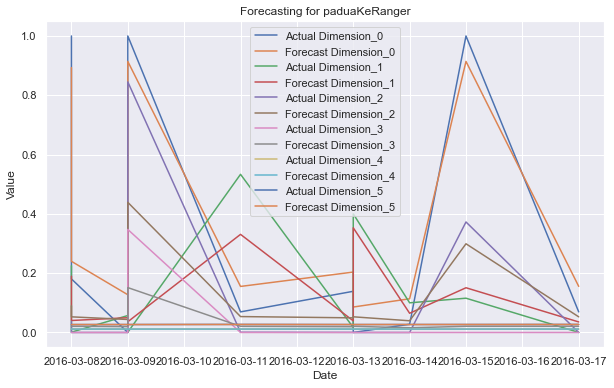

RMSE for princetonCerber: 0.01848772497301866


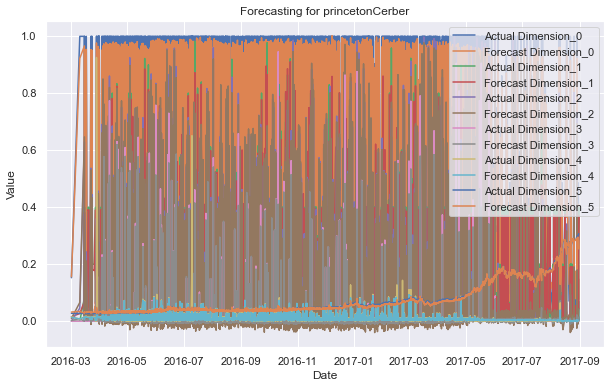

RMSE for princetonLocky: 0.0225694550186816


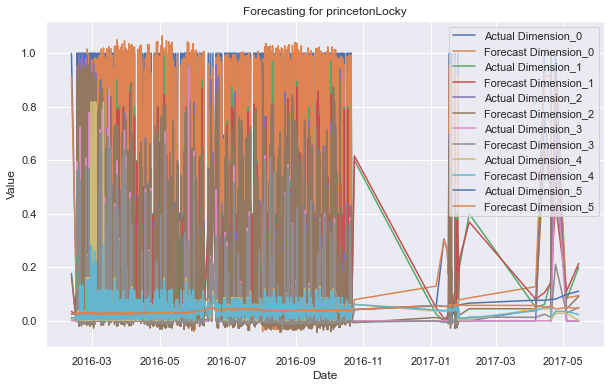

Overall RMSE: 0.0477682916508418


In [293]:
from sklearn.svm import SVR
from sklearn.multioutput import MultiOutputRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import numpy as np

# Define a function for RMSE calculation
def calculate_rmse(actual, forecast):
    return np.sqrt(mean_squared_error(actual, forecast))

# Create SVR model
svr = SVR(kernel='rbf', C=1.0, epsilon=0.2)
mor = MultiOutputRegressor(svr)

# Standardize the data
scaler_X = StandardScaler()
scaler_y = StandardScaler()

# Initialize a list to store RMSE values
rmse_list = []

# Loop through each DataFrame in the dictionary
for label, df in grouped_dict_price.items():
    # Prepare the features (X) and target (y) variables
    X = df[['Dimension_0', 'Dimension_1', 'Dimension_2','Dimension_3','Dimension_4','Dimension_5']]  # Include the relevant features
    y = df[['Dimension_0', 'Dimension_1', 'Dimension_2','Dimension_3','Dimension_4','Dimension_5']]   # Include the relevant targets

    # Standardize the data
    X_scaled = scaler_X.fit_transform(X)
    y_scaled = scaler_y.fit_transform(y)

    # Train the SVR model
    mor.fit(X_scaled, y_scaled)

    # Forecasting
    X_forecast = df[['Dimension_0', 'Dimension_1', 'Dimension_2','Dimension_3','Dimension_4','Dimension_5']]  # Include the relevant features
    X_forecast_scaled = scaler_X.transform(X_forecast)
    y_forecast_scaled = mor.predict(X_forecast_scaled)
    y_forecast = scaler_y.inverse_transform(y_forecast_scaled)

    # Calculate RMSE
    actual_values = df[['Dimension_0', 'Dimension_1', 'Dimension_2','Dimension_3','Dimension_4','Dimension_5']].values  # Replace with actual column names
    rmse = calculate_rmse(actual_values, y_forecast)
    rmse_list.append(rmse)

    # Print RMSE for this DataFrame
    print(f'RMSE for {label}: {rmse}')

    # Create a DataFrame with the forecasted values
    forecast_df = pd.DataFrame(y_forecast, columns=y.columns, index=X_forecast.index)

    # Plot the forecast
    plt.figure(figsize=(10, 6))
    for target_variable in y.columns:
        plt.plot(df.index, df[target_variable], label=f'Actual {target_variable}')
        plt.plot(forecast_df.index, forecast_df[target_variable], label=f'Forecast {target_variable}')

    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.title(f'Forecasting for {label}')
    plt.legend()
    plt.show()
# Calculate overall RMSE
overall_rmse = np.mean(rmse_list)
print(f'Overall RMSE: {overall_rmse}')

The Overall RMSE: 0.0477682916508418 is much lower in SVM model compared to Overall RMSE: 0.23921209751742203 in VAR model, the graphs in SVM is more accurate compared to the braphs in VAR. Hence we concluse SVM has better forcasting accuracy of the two.

In [300]:
grouped_dict_price

{'montrealAPT':             Dimension_0  Dimension_1  Dimension_2  Dimension_3  Dimension_4  \
 Date                                                                          
 2016-09-15     0.013889     0.600044     0.000123     0.000000     0.007317   
 2016-09-27     0.041667     0.050004     0.000000     0.000000     0.011511   
 2016-10-03     0.000000     0.200015     0.000000     0.000000     0.004464   
 2016-10-04     1.000000     0.123900     0.601182     0.000000     0.159512   
 2016-12-10     1.000000     0.480763     0.335509     0.000000     0.025982   
 2017-01-05     0.041667     0.200015     0.000000     0.000000     0.025982   
 2017-02-15     1.000000     0.069887     0.475182     0.000000     0.041440   
 2017-03-17     1.000000     0.550041     0.994581     1.000000     0.089242   
 2017-03-31     0.055556     0.125009     0.000000     0.000124     0.174082   
 2017-11-30     1.000000     0.047837     0.365439     0.000000     0.019733   
 2017-12-01     0.013889 

### LS-SVM model

In [307]:
from sklearn.svm import SVR
from sklearn.preprocessing import StandardScaler
import numpy as np

# Define a function for RMSE calculation
def calculate_rmse(actual, forecast):
    return np.sqrt(np.mean((actual - forecast)**2))

# Initialize a dictionary to store RMSE values
rmse_dict = {}

# Loop through each DataFrame in the dictionary
for label, df in grouped_dict_price.items():
    # Assuming 'time' is your datetime index
    X = df[['Dimension_0', 'Dimension_1', 'Dimension_2','Dimension_3','Dimension_4']]  # Include the relevant features
    y = df['Dimension_5']  # Include the target variable

    # Standardize the data
    scaler_X = StandardScaler()
    X_scaled = scaler_X.fit_transform(X)
    scaler_y = StandardScaler()
    y = y.values.reshape(-1, 1)  # Reshape y to 2D
    y_scaled = scaler_y.fit_transform(y)

    # Create and train the LS-SVM model
    svr = SVR(kernel='rbf', C=1.0, epsilon=0.2)
    svr.fit(X_scaled, y_scaled)
    

    # Forecasting
    X_forecast = df[['Dimension_0', 'Dimension_1', 'Dimension_2','Dimension_3','Dimension_4']]  # Include the relevant features
    X_forecast_scaled = scaler_X.transform(X_forecast)
    y_forecast_scaled = svr.predict(X_forecast_scaled)

    # Reshape y_forecast_scaled to 2D
    y_forecast_scaled = y_forecast_scaled.reshape(-1, 1)

    # Apply inverse transform
    y_forecast = scaler_y.inverse_transform(y_forecast_scaled).flatten()


    # Calculate RMSE
    actual_values = df['Dimension_5'].values
    rmse = calculate_rmse(actual_values, y_forecast)
    rmse_dict[label] = rmse

    # Print RMSE for this DataFrame
    print(f'RMSE for {label}: {rmse}')

    # Create a DataFrame with the forecasted values
    forecast_df = pd.DataFrame({'Forecasted': y_forecast.flatten()}, index=X_forecast.index)

    # Plot the forecast (if desired)
    # ... (code for plotting)

# Calculate overall RMSE
overall_rmse = np.mean(list(rmse_dict.values()))
print(f'Overall RMSE: {overall_rmse}')


C:\Users\srivi\anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\srivi\anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


RMSE for montrealAPT: 0.2282725366940733
RMSE for montrealCryptXXX: 0.005401412015242697


C:\Users\srivi\anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


RMSE for montrealCryptoLocker: 0.02215890902646806
RMSE for montrealCryptoTorLocker2015: 0.003482560205928802
RMSE for montrealDMALocker: 0.008523541779556991
RMSE for montrealDMALockerv3: 0.03662765635418774
RMSE for montrealGlobe: 0.005804543098014386
RMSE for montrealGlobeImposter: 0.13389906673834295
RMSE for montrealGlobev3: 0.01164509708180816
RMSE for montrealNoobCrypt: 0.008987060093104257
RMSE for montrealRazy: 0.09768080267746522
RMSE for montrealSamSam: 0.04334636923445071
RMSE for montrealWannaCry: 0.03120070200088538
RMSE for others: 0.09350434445118874


C:\Users\srivi\anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\srivi\anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\srivi\anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\srivi\anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

RMSE for paduaCryptoWall: 0.007858234248260635
RMSE for paduaKeRanger: 0.0001329161649123857


C:\Users\srivi\anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\Users\srivi\anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


RMSE for princetonCerber: 0.02831460895267877


C:\Users\srivi\anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


RMSE for princetonLocky: 0.0058353735965119774
Overall RMSE: 0.04292642968961562


The Overall RMSE: 0.04292642968961562 for LS-SVM is slightly lower than Overall RMSE:0.0477682916508418 in SVM model and both are much lower compared to Overall RMSE: 0.23921209751742203 in VAR model, the graphs in SVM is more accurate compared to the braphs in VAR. Hence we concluse LS-SVM has better forcasting accuracy of the three.